<a href="https://colab.research.google.com/github/markefuller/CAP4630/blob/master/hw3problem1a.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mark E Fuller
UCF CAP 4630 Fall 2019

**Homework 3 Problem 1:**

Check out the GitHub repo: https://github.com/UgurUysal86/MLS4MIL/tree/master/Image%20Classification (Links to an external site.)

My former student Ugur Uysal created a synthetic dataset of military objects and fine-tuned a convnet to classify these objects.  This was one his projects for an independent study.

For this homework, you have to work with this synthetic dataset. Before you can train on colab, you have to carry out the steps below:

1. Download the zip file https://drive.google.com/file/d/1r-AZeKXd_SvSXwOcQuqX_w9q0F0nT-uW/view?usp=sharing (Links to an external site.) to your local computer and unzip it.

2. Look at the images of the different military objects to better understand the dataset.

3. Remove the civilian car folder.

4. Zip the folder (without civilian car) and upload it to your Google drive.

5. Start a new colab notebook and mount your Google drive. Read the section "Mount Google drive locally" in https://colab.research.google.com/notebooks/io.ipynb (Links to an external site.)

6. Now you can access the dataset file.

Note that if you work for a company you may have to train machine learning models using instances in the cloud so you have to figure out how to get the dataset to the instance. The above steps mimic a little bit this process of getting data onto a remote instance.

Fine-tune a deep neural network to recognize the different military objects.
 
As the absolute minimum, you have to analyze Ugur's code and modify it so that the code doesn't expect the class "civilian cars".  

Try to get the best possible results, try to experiment with different pretrained convnets. It's your chance to put everything to use to solve a non-trivial computer vision problem.

# Imports


In [1]:
from google.colab import files, drive
drive.mount('/content/drive', force_remount=True)

import os
from keras.applications import NASNetLarge
from keras import models, layers, optimizers, backend
from keras.models import load_model
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard
import matplotlib.pyplot as plt
import numpy as np
from timeit import default_timer as timer
from tensorflow.python.client import device_lib

Mounted at /content/drive


Using TensorFlow backend.


# Validate Running on GPU

In [2]:
for x in device_lib.list_local_devices():
   if x.device_type == "GPU":
     print("***** GPU Information *****")
     print("Device Name: " , x.name)
     print("Memory Limit: " , "%.2f" % float(x.memory_limit/(1000*1000*1000)), "GB")
     print("Description: " , x.physical_device_desc)

***** GPU Information *****
Device Name:  /device:GPU:0
Memory Limit:  15.96 GB
Description:  device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


# Get Images Directly on Colab Machine

In [3]:
!rm -rf /content/HW3
!mkdir -p /content/HW3/datasets
!mkdir -p /content/HW3/trained_models/trained_weights
!mkdir -p /content/HW3/logs
!cp "/content/drive/My Drive/Colab Notebooks/CAP4630/HW3/datasets/RuTanks7000_v2.zip" /content/HW3/datasets
!unzip -q /content/HW3/datasets/RuTanks7000_v2.zip -d /content/HW3/datasets
print("Number of Training Images Unzipped:")
!ls -laR /content/HW3/datasets/train | grep -i jpg | wc -l
print("Number of Testing Images Unzipped:")
!ls -laR /content/HW3/datasets/test | grep -i jpg | wc -l
print("Subdirectories (Image Classes):")
!ls /content/HW3/datasets/train

Number of Training Images Unzipped:
42000
Number of Testing Images Unzipped:
90
Subdirectories (Image Classes):
Background  BMP2  Buk-M1-2  T14  T90  ZSU23


# Settings

In [0]:
# image settings
img_height,img_width = 331, 331  # For NASNetLarge

In [0]:
# classes
# classnames = ["Background", "BMP2", "Buk-M1-2", "Civilian Car", "T14", "T90", "ZSU23"]
classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]
classes = len(classnames)

In [0]:
# path settings
path = '/content/HW3/'
dataset_path = path + 'datasets/'
weights_path = path + 'trained_models/trained_weights/weights_temp.h5'
model_path = path + 'trained_models/RuTanks7000_v2_'
TensorBoardLogDir = path + 'logs'

In [0]:
nbrTrainImages = 7000  # per class
nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)
for ImagesClass in os.listdir(dataset_path+'test/'):
    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))

In [0]:
# unfreezing the base network up to a specific layer in Level2:
freezeUptoLayer = "normal_add_1_15"   # NASNetLarge

# hyperparameters
learning_rate = 0.0002  # Learning_rate in Level 2 = learning_rate/10
lr_decay = 0.0001
batch = 64
fcLayer1 = 32
dropout = 0.5

epochsL1 = 10
patiencel1 = 1
factorL1 = 0.5

epochsL2 = 10
patiencel2 = 1
factorL2 = 0.5

verbose_train = 1

# Data Generators

In [9]:
# datagenerators https://keras.io/preprocessing/image/
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    fill_mode='nearest',
    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
    dataset_path+'train',
    target_size=(img_height, img_width),
    batch_size=batch,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    dataset_path+'test',
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=True,
    classes=classnames,
    class_mode='categorical')

Found 42000 images belonging to 6 classes.
Found 90 images belonging to 6 classes.


# Function Definitions

In [0]:
def plot(h,t,e):
    history_dict = h[0]
    loss_values = history_dict['loss']
    validation_loss_values = history_dict['val_loss']
    acc_values = history_dict['acc']
    validation_acc_values = history_dict['val_acc']
    epochs_range = range(1, e + 1)

    # Plotting Training and Validation loss of the corresponding Model
    plt.plot(epochs_range, loss_values, 'bo', label='Training loss')
    plt.plot(epochs_range, validation_loss_values, 'ro', label='Validation loss')
    plt.title('Training and validation loss of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.yticks(np.arange(0, 3.1, step=0.2))
    plt.legend()
    plt.show()

    # Plotting Training and Validation accuracy of the corresponding Model
    plt.plot(epochs_range, acc_values, 'bo', label='Training accuracy')
    plt.plot(epochs_range, validation_acc_values, 'ro', label='Validation accuracy')
    plt.title('Training and validation accuracy of ' + t)
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.yticks(np.arange(0.3, 1.1, step=0.1))
    plt.legend()
    plt.show()
    

In [0]:
def level1():
    # Building the model using the pretrained model
    conv_base1 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    print("\n### LEVEL1 ###\npretrained network:")
    conv_base1.summary()
    model = models.Sequential()
    model.add(conv_base1)
    model.add(layers.GlobalAveragePooling2D())
    model.add(layers.Dense(fcLayer1, activation='relu'))
    model.add(layers.Dropout(dropout))
    model.add(layers.Dense(classes, activation='softmax'))

    # freezing the base network
    print("trainable layers bevor freezing:", int(len(model.trainable_weights)/2)) # weights = weights + bias = 2 pro layer
    conv_base1.trainable = False
    print("\n===========================================================\n")
    print("trainable layers after freezing:", int(len(model.trainable_weights)/2))
    print("\npretrained network + densely connected classifier")
    print("\n===========================================================\n")
    model.summary()

    # training the added layers only
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate, decay=lr_decay), metrics=['acc'])

    callbacks_list_L1 = [ModelCheckpoint(filepath=weights_path, save_weights_only=True, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL1, patience=patiencel1, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level1')]

    print("\n### Level1 Training ... ")
    # training the model
    history = model.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL1,
        callbacks=callbacks_list_L1,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val1 = [history.history]  # saving all results of the final test
    plot(history_val1, "LEVEL1:", epochsL1)
    print("\n### LEVEL1 Training finished successfully ###")

    print("\nLoading trained weights from " + weights_path + " ...")
    model.load_weights(weights_path)
    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate), metrics=['acc'])
    print("\n### Saving Level1 Model to ", model_path+'l1.h5', " ... ")
    model.save(model_path+'l1.h5')
    

In [0]:
def level2():
    # Destroying the current TF graph - https://keras.io/backend/
    backend.clear_session()
    print("\n### LEVEL2 ###")
    conv_base2 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))
    model2 = models.Sequential()
    model2.add(conv_base2)
    model2.add(layers.GlobalAveragePooling2D())
    model2.add(layers.Dense(fcLayer1, activation='relu'))
    model2.add(layers.Dropout(dropout))
    model2.add(layers.Dense(classes, activation='softmax'))

    print("\nLoading trained weights from " + weights_path + " ...")
    model2.load_weights(weights_path)

    # unfreezing the base network up to a specific layer:
    if freezeUptoLayer == "":
        conv_base2.trainable = True
        print ("\ntrainable layers: ",int(len(model2.trainable_weights) / 2))
    else:
        print("\ntrainable layers before unfreezing the base network up to " + freezeUptoLayer + ": ",int(len(model2.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer
        conv_base2.trainable = True
        set_trainable = False
        for layer in conv_base2.layers:
            if layer.name == freezeUptoLayer: set_trainable = True
            if set_trainable: layer.trainable = True
            else: layer.trainable = False
        print("trainable layers after the base network unfreezed from layer " + freezeUptoLayer + ": ", int(len(model2.trainable_weights)/2))

    print("\n===========================================================\n")
    print("\nLEVEL2 Model after unfreezing the base network")
    model2.summary()
    print("\n===========================================================\n")
    model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate/10, decay=lr_decay), metrics=['acc'])
    print ("\n### Validating ... ")

    val_loss, val_acc = model2.evaluate_generator(test_generator, steps=nbrTestImages, verbose=0)
    print('Validation Results before training unfreeze layers and trained densely connected layers:\nValidation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")

    # Jointly training both the unfreeze layers and the added trained densely connected layers
    callbacks_list_L2 = [ModelCheckpoint(filepath=model_path+'l2.h5', save_weights_only=False, monitor='val_acc', verbose=1, save_best_only=True),
                      ReduceLROnPlateau(monitor='val_acc', factor=factorL2, patience=patiencel2, verbose=1),
                      TensorBoard(log_dir=TensorBoardLogDir+'\\level2')]

    print ("\n### Level2 Training ... ")
    history = model2.fit_generator(
        train_generator,
        steps_per_epoch=(nbrTrainImages * classes) // (batch * 5),
        epochs=epochsL2,
        callbacks=callbacks_list_L2,
        validation_data=test_generator,
        validation_steps=nbrTestImages,
        verbose=verbose_train)

    history_val2 = [history.history]  # saving all results of the final test
    plot(history_val2, "LEVEL2:", epochsL2)
    print("\n###LEVEL2 Training finished successfully ###")

# Level 1 Training















343613440/343610240 [==============================] - 10s 0us/step

### LEVEL1 ###
pretrained network:
Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 331, 331, 3)  0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_1[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 165, 165, 96) 0           stem_bn1[

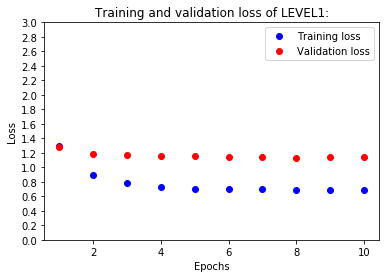

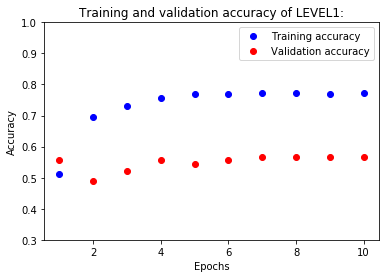


### LEVEL1 Training finished successfully ###

Loading trained weights from /content/HW3/trained_models/trained_weights/weights_temp.h5 ...

### Saving Level1 Model to  /content/HW3/trained_models/RuTanks7000_v2_l1.h5  ... 
Level 1 training time elapsed in minutes:  38.52395044201667


In [13]:
startL1 = timer()
level1()  # Training the classifier only
endL1 = timer()
print("Level 1 training time elapsed in minutes: ", ((endL1 - startL1)/60))

# Level 2 Training



### LEVEL2 ###

Loading trained weights from /content/HW3/trained_models/trained_weights/weights_temp.h5 ...

trainable layers before unfreezing the base network up to normal_add_1_15:  510
trainable layers after the base network unfreezed from layer normal_add_1_15:  71



LEVEL2 Model after unfreezing the base network
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
____________________________________________________________

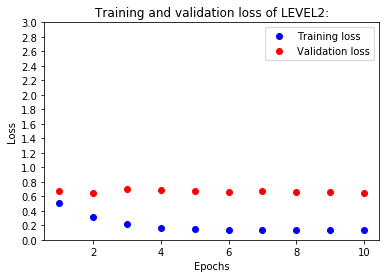

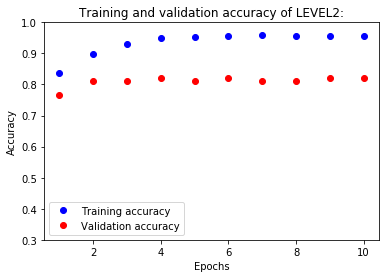


###LEVEL2 Training finished successfully ###
Level 2 training time elapsed in minutes:  44.60365012321666


In [14]:
startL2 = timer()
level2()  # Training the pretrained model + the trained classifier from level 1
endL2 = timer()
print("Level 2 training time elapsed in minutes: ", ((endL2 - startL2)/60))

# Additional Imports for Analysis

In [0]:
from keras.preprocessing import image
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.manifold import TSNE
import seaborn as sns

# Analysis Settings

In [0]:
model_path = '/content/HW3/trained_models/RuTanks7000_v2_l2.h5'
test_path = '/content/HW3/datasets/test/'  #  90 Test images

img_height, img_width = 331, 331

classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]


# Analysis Test Data Generator

In [17]:
test_datagen = image.ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_path,
    target_size=(img_height, img_width),
    batch_size=1,
    shuffle=False,
    classes=classnames,
    class_mode='categorical')

# counting test images
nbrTestImages = 0  # Value gets accurate after counting
for ImagesClass in os.listdir(test_path):
    nbrTestImages += len(os.listdir(test_path + ImagesClass))


Found 90 images belonging to 6 classes.


# Saving Test Images from Analysis Test Generator

In [0]:
test_images = []
for i in range(nbrTestImages):
    test_images.append(test_generator.next()[0][0])

test_images_path = []
true_labels = []
true_labels_class = []

test_images_Background = os.listdir(test_path + 'Background')
for imagefile in test_images_Background:
    test_images_path.append(test_path + 'Background/' + imagefile)
    true_labels.append(0)
    true_labels_class.append('Background')

test_images_BMP2 = os.listdir(test_path + 'BMP2')
for imagefile in test_images_BMP2:
    test_images_path.append(test_path + 'BMP2/' + imagefile)
    true_labels.append(1)
    true_labels_class.append('BMP2')

test_images_Buk = os.listdir(test_path + 'Buk-M1-2')
for imagefile in test_images_Buk:
    test_images_path.append(test_path + 'Buk-M1-2/' + imagefile)
    true_labels.append(2)
    true_labels_class.append('Buk-M1-2')

test_images_T14 = os.listdir(test_path + 'T14')
for imagefile in test_images_T14:
    test_images_path.append(test_path + 'T14/' + imagefile)
    true_labels.append(3)
    true_labels_class.append('T14')

test_images_T90 = os.listdir(test_path + 'T90')
for imagefile in test_images_T90:
    test_images_path.append(test_path + 'T90/' + imagefile)
    true_labels.append(4)
    true_labels_class.append('T90')

test_images_ZSU23 = os.listdir(test_path + 'ZSU23')
for imagefile in test_images_ZSU23:
    test_images_path.append(test_path + 'ZSU23/' + imagefile)
    true_labels.append(5)
    true_labels_class.append('ZSU23')


# Use Previous Model

In [19]:
print("Loading the trained model from " + model_path + " ...\n")
model = models.load_model(model_path)
print("\nTrained model " + model_path + ":")
model.summary()

# predicting labels
pred = model.predict_generator(test_generator, nbrTestImages)
print("Dataset at", test_path, "has", pred.shape[0], "images with", pred.shape[1], "class predictions each")

Loading the trained model from /content/HW3/trained_models/RuTanks7000_v2_l2.h5 ...


Trained model /content/HW3/trained_models/RuTanks7000_v2_l2.h5:
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 198       
Total params: 85,046,072
Trainable params: 30,292,646
Non-trainable params: 54,753,426
_______________

# Analysis Functions

In [0]:
def analysis():
    # testing the model
    print("\n### Testing the loaded model ... ")
    test_loss, test_acc = model.evaluate_generator(test_generator, steps=nbrTestImages, verbose=1)
    print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)

    # Confusion Matrix and Classification Report
    pred_argmax = np.argmax(pred, axis=1)
    print('\nConfusion Matrix')
    print(confusion_matrix(test_generator.classes, pred_argmax))
    print('\nClassification Report')
    print(classification_report(test_generator.classes, pred_argmax, target_names=classnames))

    # t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.
    img_tensors = []
    for i in range(len(test_images)):
        pred_img = image.load_img(test_images_path[i], target_size=(331, 331))
        img_tensor = image.img_to_array(pred_img)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.
        img_tensors.append(img_tensor)

    # Last conv layer
    layer = model.get_layer('dense_1')
    layer_output = layer.output
    activation_model = models.Model(input=model.input, outputs=[layer_output])

    img_tensors = np.asarray(img_tensors)
    img_tensors_array = np.concatenate((img_tensors))
    print("img_tensors_array.shape=", img_tensors_array.shape)

    activations = activation_model.predict(img_tensors_array)
    print("activations.shape=", activations.shape)

    # calculating tsne #https://www.datacamp.com/community/tutorials/introduction-t-sne
    tsne = TSNE(random_state=42).fit_transform(activations)

    # Visualization of the feature vectors produce by the convnet
    num_classes = len(classnames)
    palette = np.array(sns.color_palette("husl", num_classes))
    label_array = np.asarray(true_labels)

    # create a scatter plot.
    fig = plt.figure(figsize=(12, 12))
    fig.patch.set_facecolor('black')
    plt.style.use('dark_background')
    plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[label_array])
    plt.axis('tight')

    txts = []
    for j in range(num_classes):
        # Position of each label at median of data points.
        xtext, ytext = np.median(tsne[label_array == j, :], axis=0)
        txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')
        txts.append(txt)
    plt.show()


In [0]:
def plot_images():
    # plotting test images with class predictions as title
    print("\nClass Predictions of test images from", test_path)
    for k in range(len(test_images)):
        predictions = []
        for l in range(len(classnames)):
            predictions.append((np.round(pred[k][l] * 100, 2), classnames[l]))
        predictions.sort(reverse=True)
        print("Image", k + 1, ":", predictions)

        plt.figure(figsize=(8, 8))  # width, height in inches.
        plt.style.use('dark_background')
        plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        legend_string = "Prediction: " + \
                        "\n%.2f" % predictions[0][0] + "% " + predictions[0][1] + \
                        "\n%.2f" % predictions[1][0] + "% " + predictions[1][1] + \
                        "\n%.2f" % predictions[2][0] + "% " + predictions[2][1] + \
                        "\n%.2f" % predictions[3][0] + "% " + predictions[3][1] + \
                        "\n%.2f" % predictions[4][0] + "% " + predictions[4][1] + \
                        "\n%.2f" % predictions[5][0] + "% " + predictions[5][1]
        plt.text(img_width + 10, 125, legend_string, fontsize=16)
        plt.imshow(test_images[k])
        plt.show()

# Run Analysis


### Testing the loaded model ... 
90/90 [==============================] - 19s 209ms/step
Test Results of the trained Model:
Test loss: 0.6833992475669624 , test accuracy: 0.8222222222222222

Confusion Matrix
[[15  0  0  0  0  0]
 [ 1 12  1  1  0  0]
 [ 0  0 15  0  0  0]
 [ 0  2  2  9  0  2]
 [ 0  0  0  1 14  0]
 [ 0  1  5  0  0  9]]

Classification Report
              precision    recall  f1-score   support

  Background       0.94      1.00      0.97        15
        BMP2       0.80      0.80      0.80        15
    Buk-M1-2       0.65      1.00      0.79        15
         T14       0.82      0.60      0.69        15
         T90       1.00      0.93      0.97        15
       ZSU23       0.82      0.60      0.69        15

    accuracy                           0.82        90
   macro avg       0.84      0.82      0.82        90
weighted avg       0.84      0.82      0.82        90



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:26: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("NA...)`


img_tensors_array.shape= (90, 331, 331, 3)
activations.shape= (90, 32)


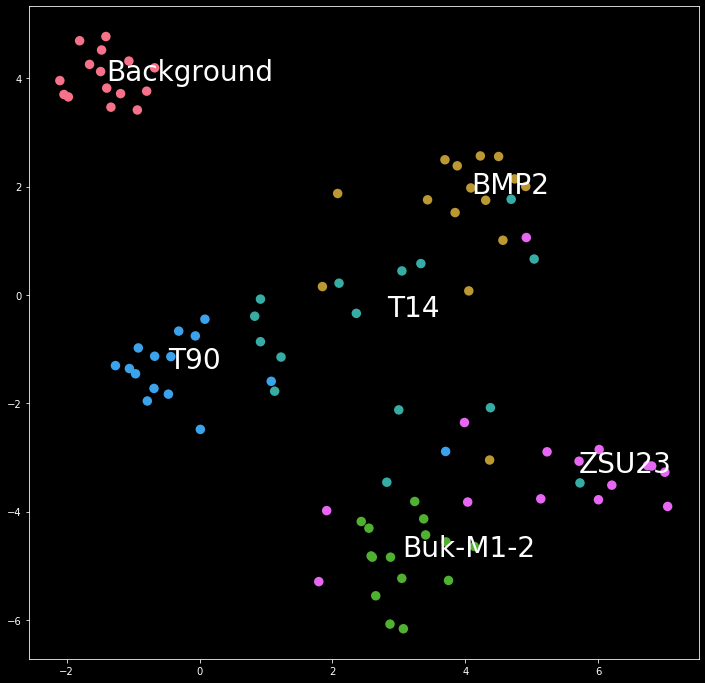

In [22]:
analysis()

# Visualize Results


Class Predictions of test images from /content/HW3/datasets/test/
Image 1 : [(99.93, 'Background'), (0.04, 'T90'), (0.01, 'T14'), (0.01, 'Buk-M1-2'), (0.01, 'BMP2'), (0.0, 'ZSU23')]


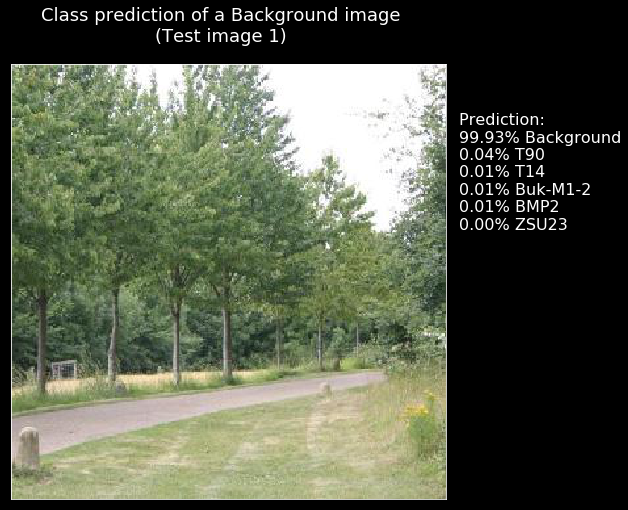

Image 2 : [(99.67, 'Background'), (0.14, 'T90'), (0.09, 'BMP2'), (0.06, 'T14'), (0.04, 'Buk-M1-2'), (0.01, 'ZSU23')]


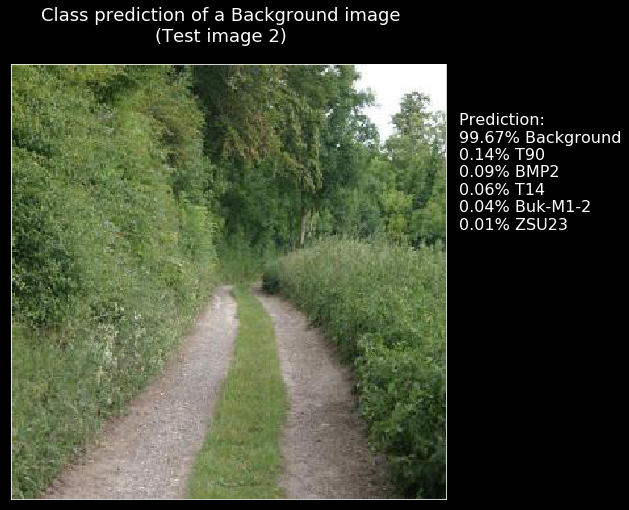

Image 3 : [(99.87, 'Background'), (0.07, 'T90'), (0.03, 'Buk-M1-2'), (0.02, 'T14'), (0.02, 'BMP2'), (0.0, 'ZSU23')]


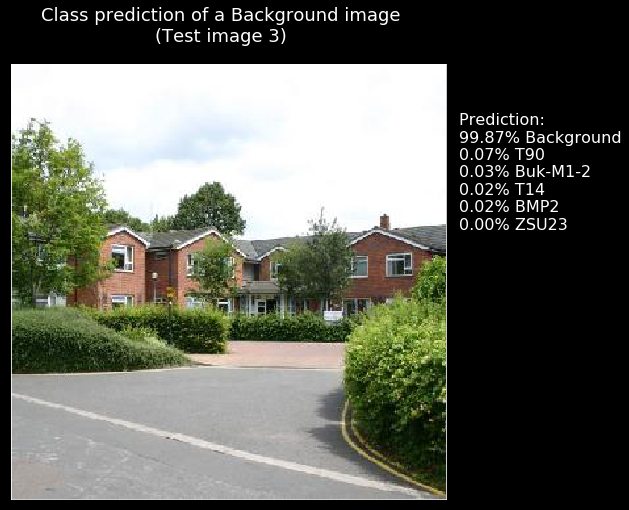

Image 4 : [(99.47, 'Background'), (0.42, 'T90'), (0.07, 'Buk-M1-2'), (0.02, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')]


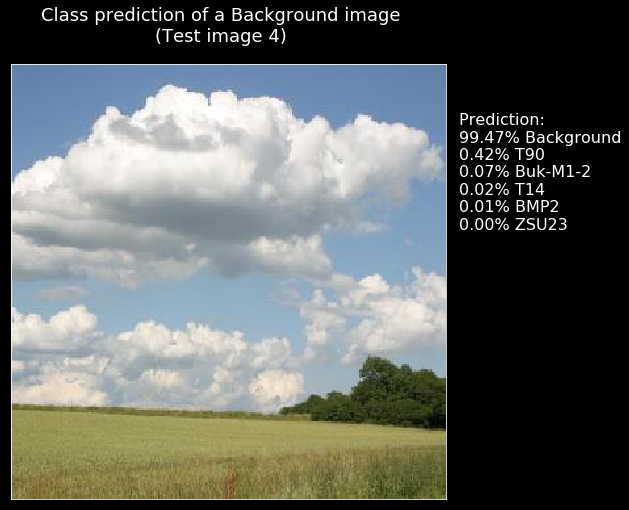

Image 5 : [(99.11, 'Background'), (0.45, 'T90'), (0.18, 'Buk-M1-2'), (0.14, 'BMP2'), (0.11, 'T14'), (0.01, 'ZSU23')]


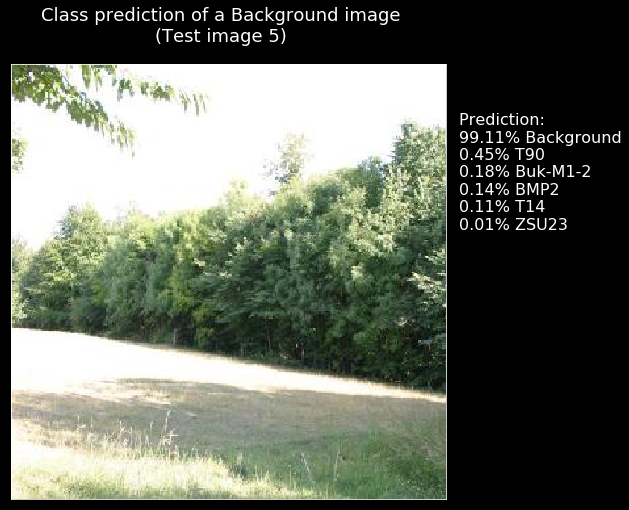

Image 6 : [(99.97, 'Background'), (0.01, 'T90'), (0.01, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14'), (0.0, 'Buk-M1-2')]


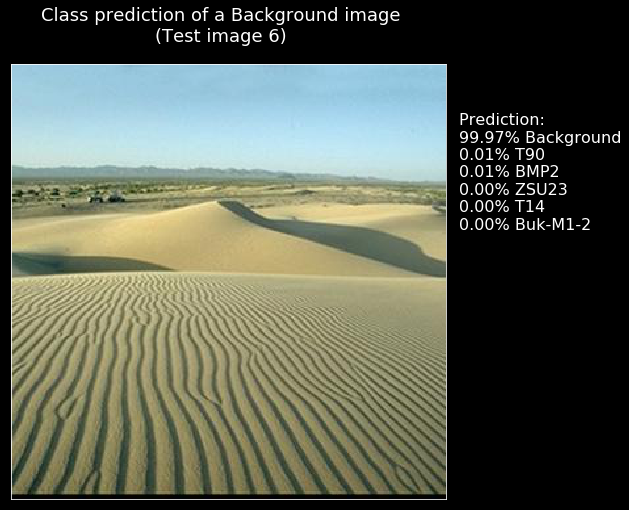

Image 7 : [(99.96, 'Background'), (0.03, 'T90'), (0.01, 'Buk-M1-2'), (0.01, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14')]


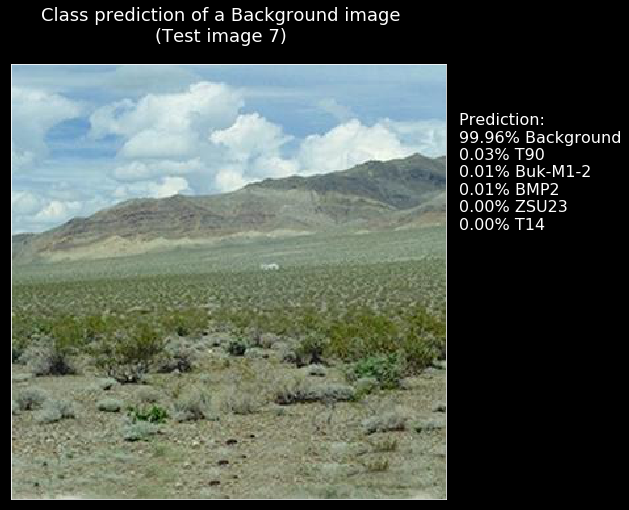

Image 8 : [(99.03, 'Background'), (0.49, 'T90'), (0.31, 'T14'), (0.14, 'BMP2'), (0.02, 'Buk-M1-2'), (0.0, 'ZSU23')]


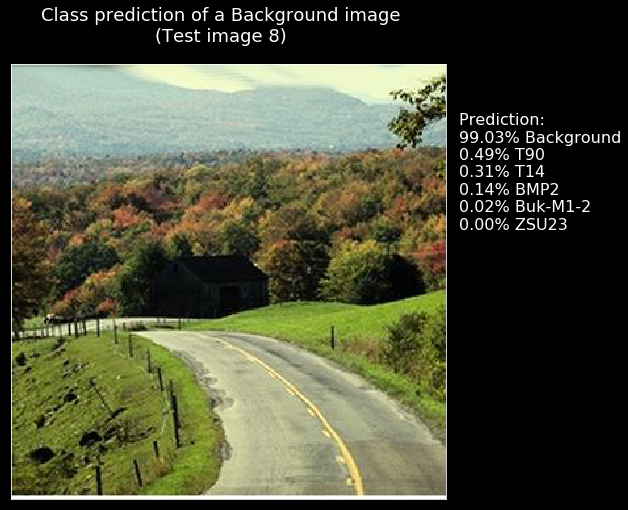

Image 9 : [(99.87, 'Background'), (0.06, 'T90'), (0.04, 'T14'), (0.02, 'BMP2'), (0.01, 'Buk-M1-2'), (0.0, 'ZSU23')]


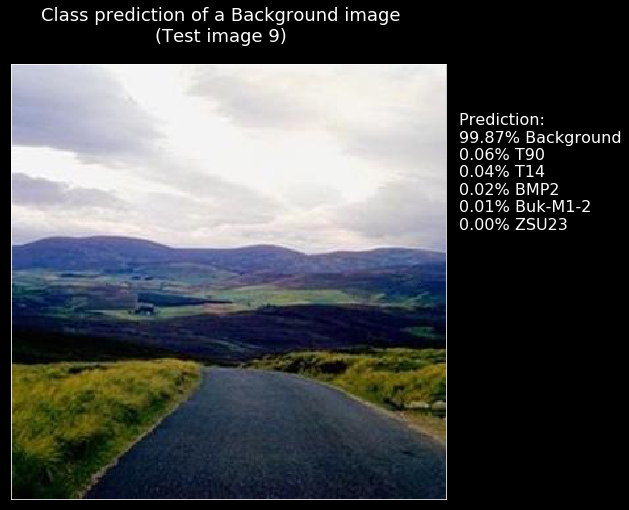

Image 10 : [(99.72, 'Background'), (0.13, 'T14'), (0.09, 'T90'), (0.06, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'Buk-M1-2')]


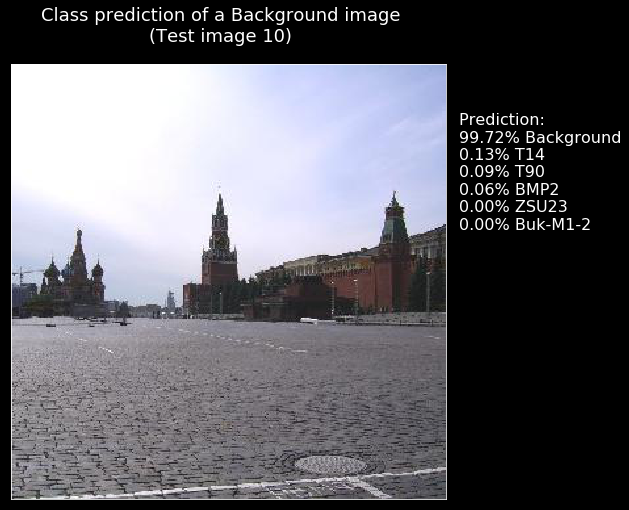

Image 11 : [(99.53, 'Background'), (0.26, 'T90'), (0.07, 'Buk-M1-2'), (0.07, 'BMP2'), (0.06, 'T14'), (0.01, 'ZSU23')]


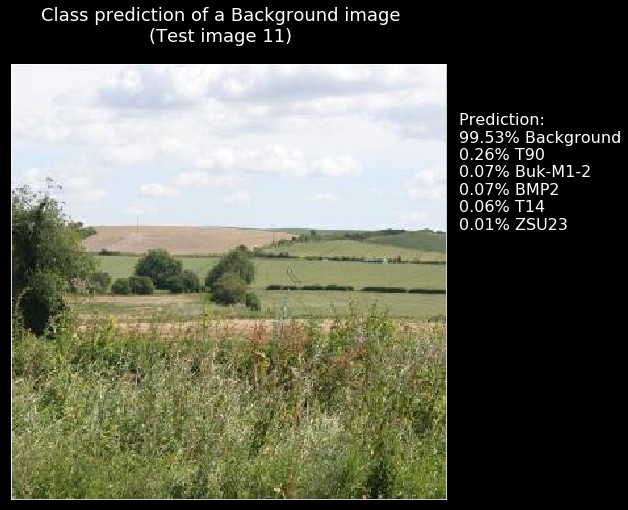

Image 12 : [(99.33, 'Background'), (0.49, 'T90'), (0.14, 'Buk-M1-2'), (0.02, 'T14'), (0.02, 'BMP2'), (0.01, 'ZSU23')]


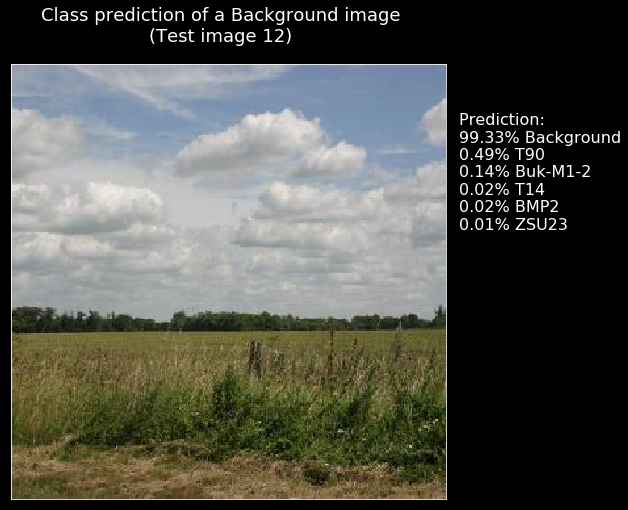

Image 13 : [(99.7, 'Background'), (0.22, 'T90'), (0.06, 'Buk-M1-2'), (0.01, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')]


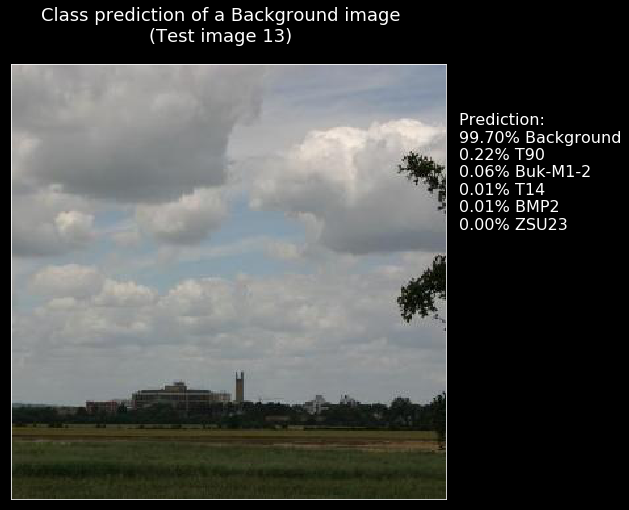

Image 14 : [(99.89, 'Background'), (0.05, 'Buk-M1-2'), (0.03, 'T90'), (0.01, 'T14'), (0.01, 'BMP2'), (0.0, 'ZSU23')]


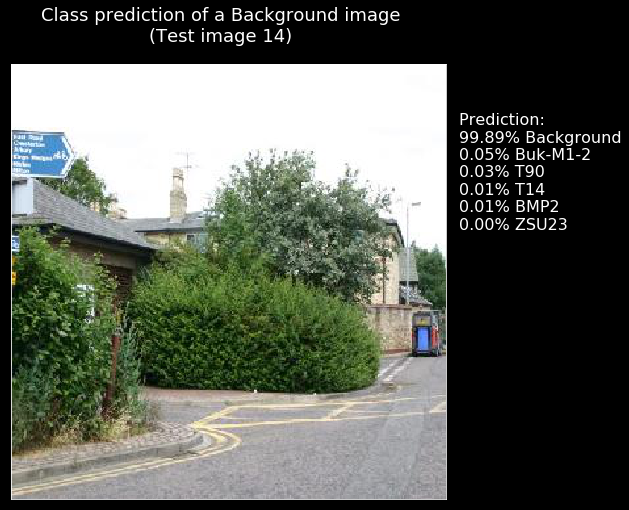

Image 15 : [(98.65, 'Background'), (0.57, 'T90'), (0.44, 'T14'), (0.21, 'BMP2'), (0.13, 'Buk-M1-2'), (0.01, 'ZSU23')]


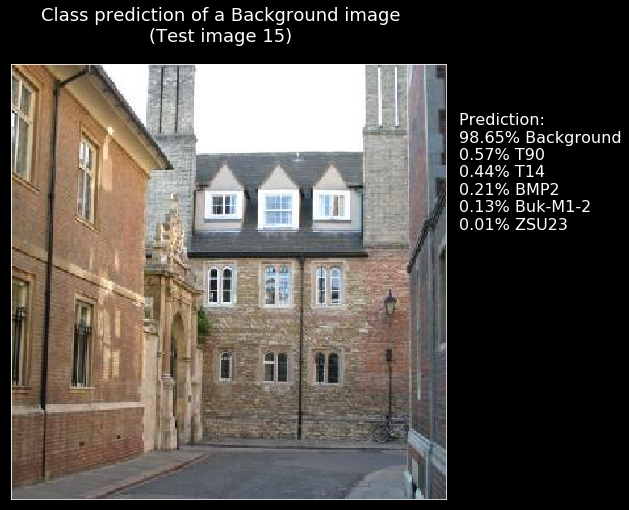

Image 16 : [(96.14, 'BMP2'), (1.61, 'T14'), (1.51, 'ZSU23'), (0.41, 'T90'), (0.28, 'Background'), (0.06, 'Buk-M1-2')]


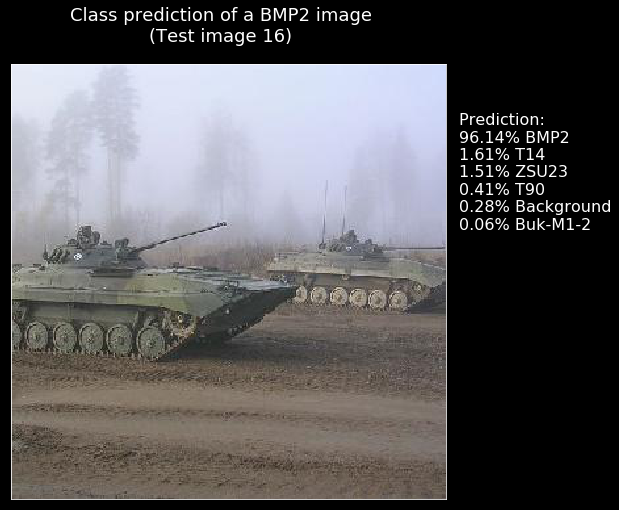

Image 17 : [(99.16, 'BMP2'), (0.25, 'ZSU23'), (0.24, 'T14'), (0.23, 'T90'), (0.09, 'Background'), (0.03, 'Buk-M1-2')]


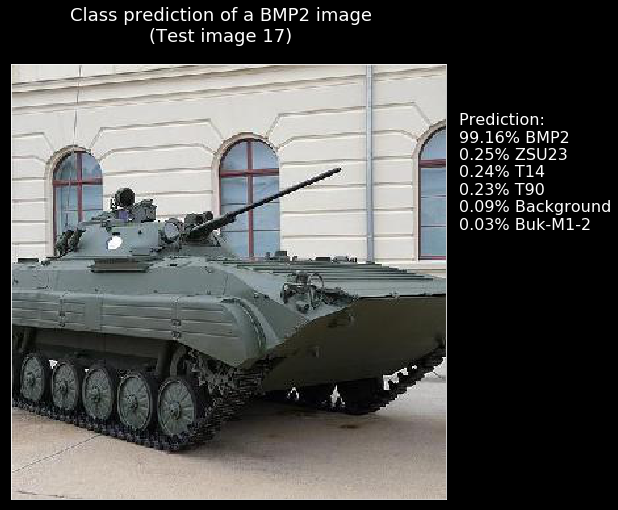

Image 18 : [(60.34, 'Buk-M1-2'), (24.95, 'ZSU23'), (8.27, 'T90'), (3.32, 'BMP2'), (2.67, 'Background'), (0.44, 'T14')]


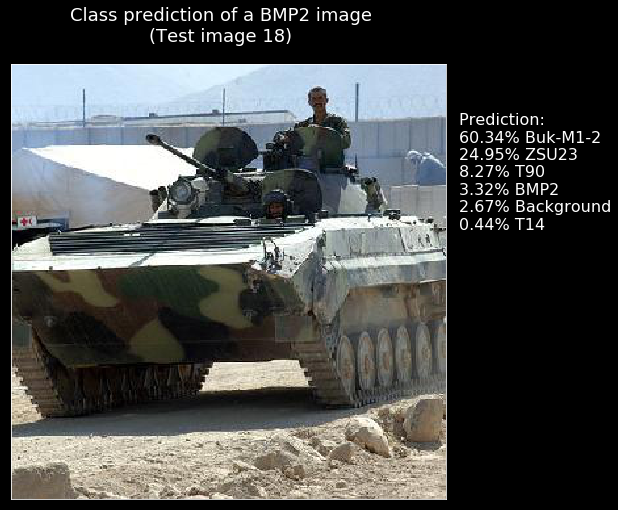

Image 19 : [(82.54, 'BMP2'), (6.11, 'T90'), (4.06, 'Background'), (3.42, 'T14'), (3.22, 'ZSU23'), (0.65, 'Buk-M1-2')]


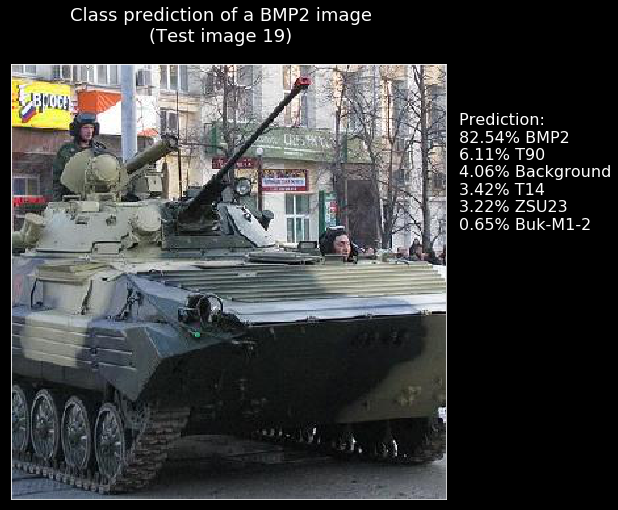

Image 20 : [(89.83, 'BMP2'), (8.4, 'T90'), (0.68, 'T14'), (0.51, 'Background'), (0.49, 'ZSU23'), (0.1, 'Buk-M1-2')]


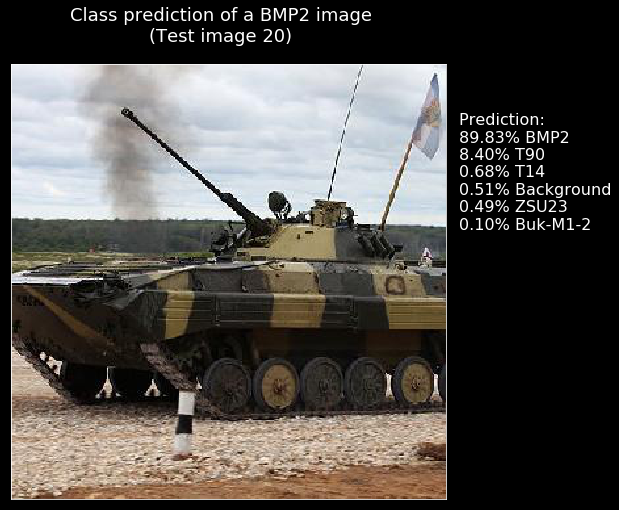

Image 21 : [(66.27, 'BMP2'), (20.62, 'Buk-M1-2'), (4.37, 'T14'), (4.35, 'ZSU23'), (4.21, 'Background'), (0.18, 'T90')]


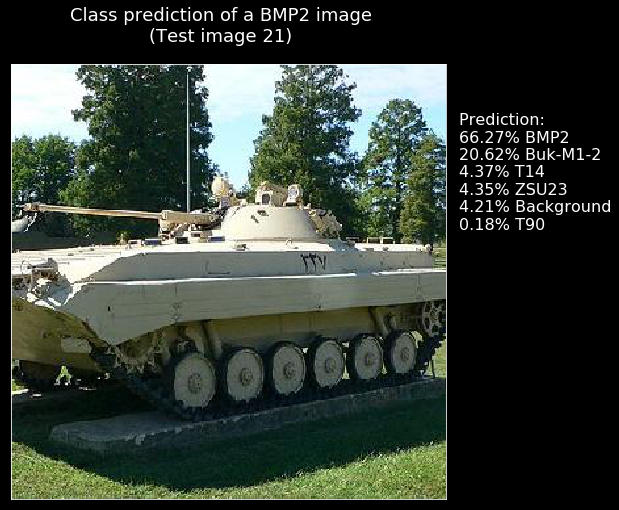

Image 22 : [(96.26, 'BMP2'), (1.74, 'ZSU23'), (0.77, 'T90'), (0.57, 'T14'), (0.41, 'Background'), (0.26, 'Buk-M1-2')]


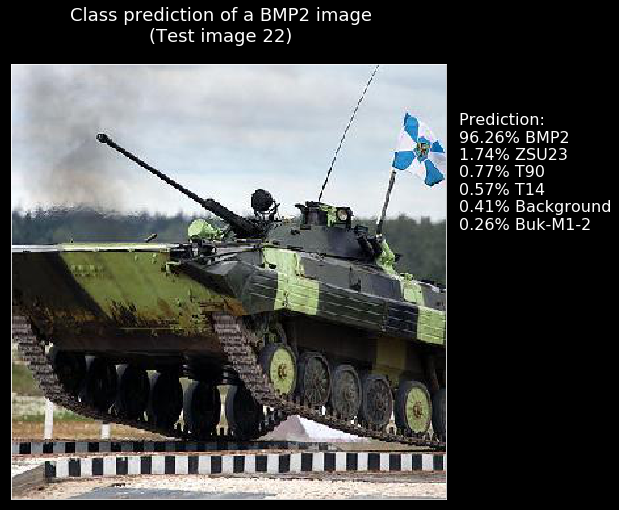

Image 23 : [(97.77, 'BMP2'), (1.07, 'T90'), (0.79, 'ZSU23'), (0.16, 'T14'), (0.15, 'Buk-M1-2'), (0.07, 'Background')]


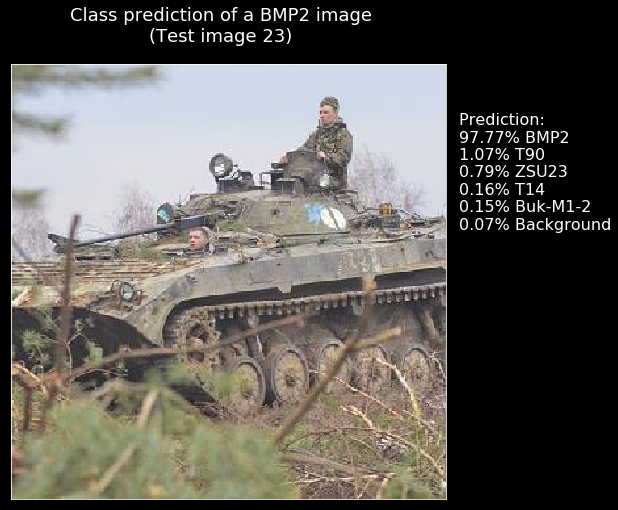

Image 24 : [(90.15, 'BMP2'), (6.81, 'T14'), (1.26, 'ZSU23'), (0.87, 'T90'), (0.81, 'Background'), (0.1, 'Buk-M1-2')]


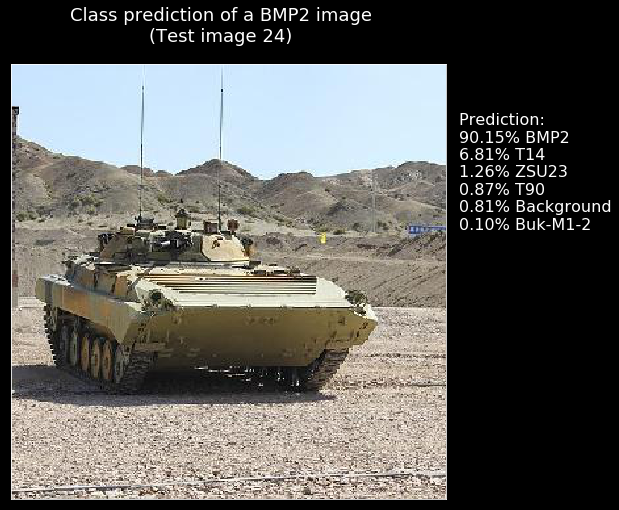

Image 25 : [(99.31, 'BMP2'), (0.39, 'T14'), (0.15, 'T90'), (0.12, 'ZSU23'), (0.02, 'Background'), (0.01, 'Buk-M1-2')]


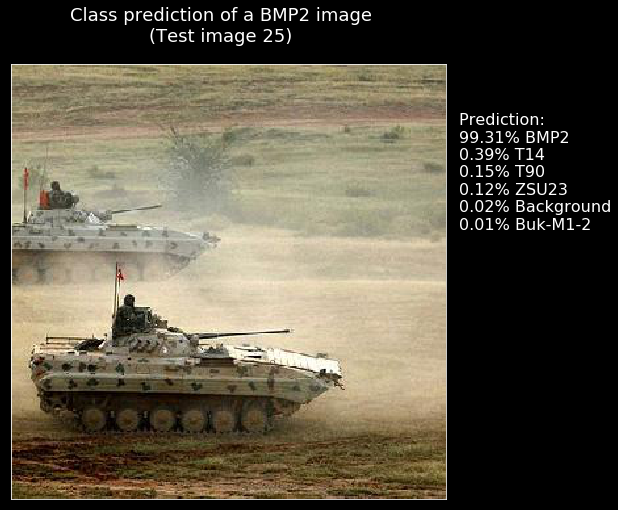

Image 26 : [(79.46, 'BMP2'), (11.65, 'T90'), (6.81, 'ZSU23'), (0.75, 'Background'), (0.68, 'T14'), (0.66, 'Buk-M1-2')]


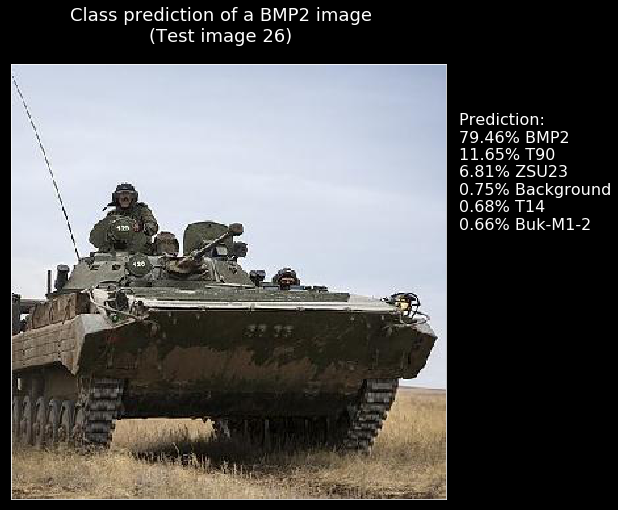

Image 27 : [(63.67, 'T14'), (14.28, 'BMP2'), (9.87, 'T90'), (8.74, 'Background'), (3.14, 'Buk-M1-2'), (0.29, 'ZSU23')]


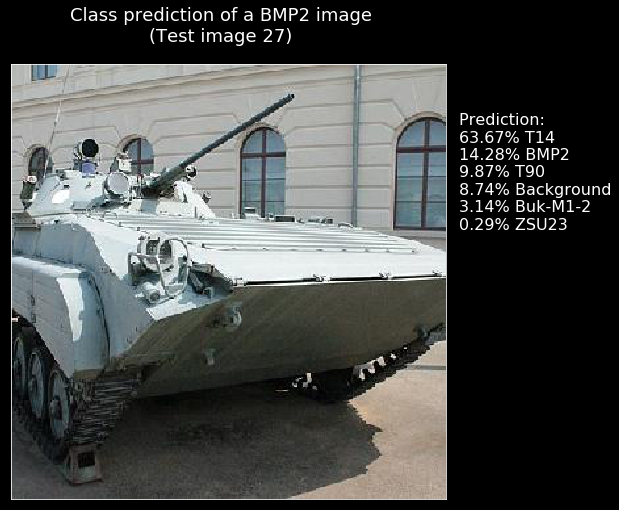

Image 28 : [(96.19, 'BMP2'), (2.46, 'T90'), (0.71, 'ZSU23'), (0.51, 'T14'), (0.1, 'Background'), (0.03, 'Buk-M1-2')]


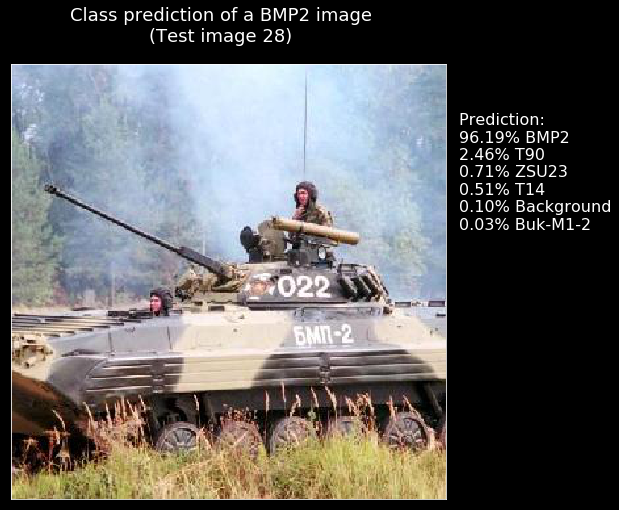

Image 29 : [(64.09, 'Background'), (26.21, 'BMP2'), (4.67, 'T14'), (3.98, 'T90'), (0.79, 'ZSU23'), (0.27, 'Buk-M1-2')]


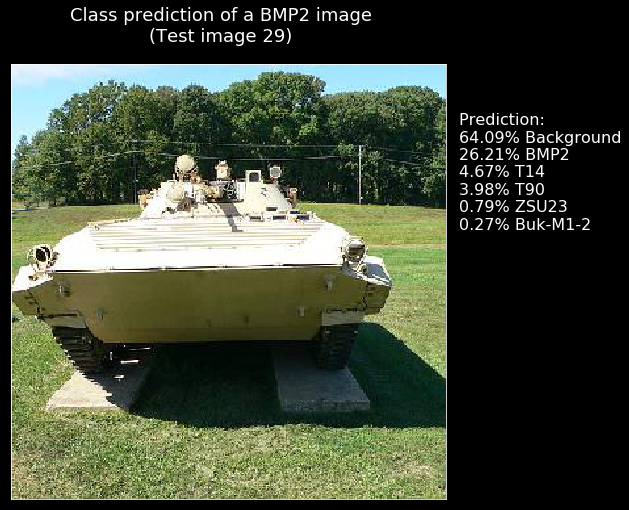

Image 30 : [(90.92, 'BMP2'), (8.46, 'T14'), (0.27, 'ZSU23'), (0.25, 'Background'), (0.05, 'T90'), (0.04, 'Buk-M1-2')]


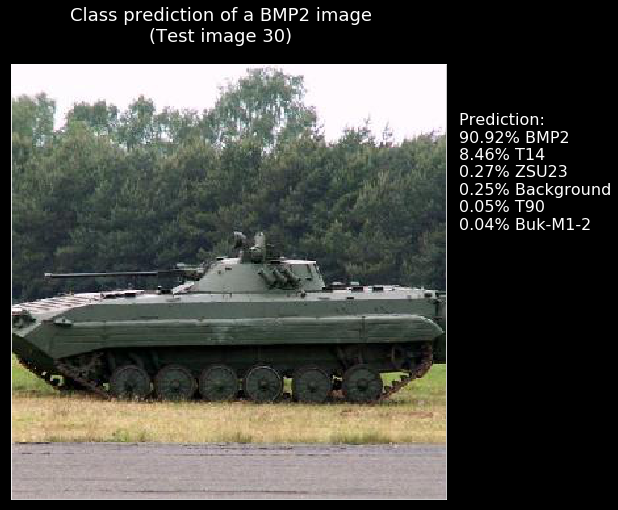

Image 31 : [(99.99, 'Buk-M1-2'), (0.01, 'ZSU23'), (0.0, 'T90'), (0.0, 'T14'), (0.0, 'Background'), (0.0, 'BMP2')]


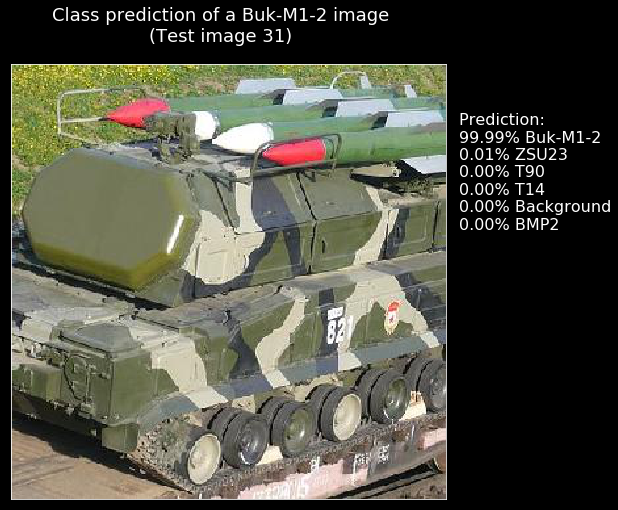

Image 32 : [(99.34, 'Buk-M1-2'), (0.24, 'T90'), (0.16, 'BMP2'), (0.13, 'Background'), (0.1, 'ZSU23'), (0.04, 'T14')]


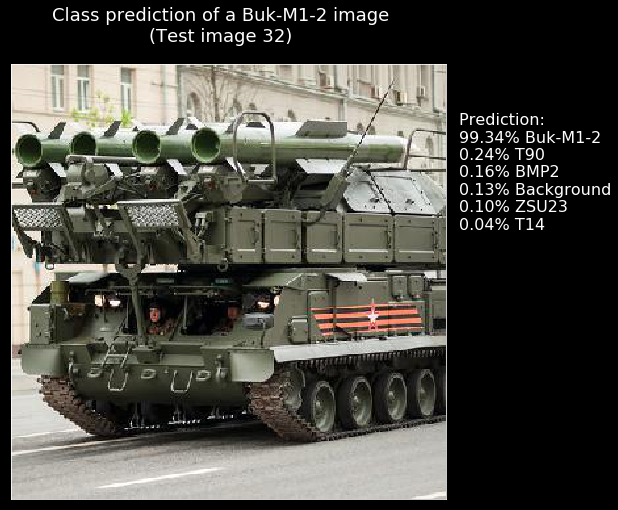

Image 33 : [(99.65, 'Buk-M1-2'), (0.13, 'T90'), (0.11, 'Background'), (0.07, 'BMP2'), (0.03, 'ZSU23'), (0.02, 'T14')]


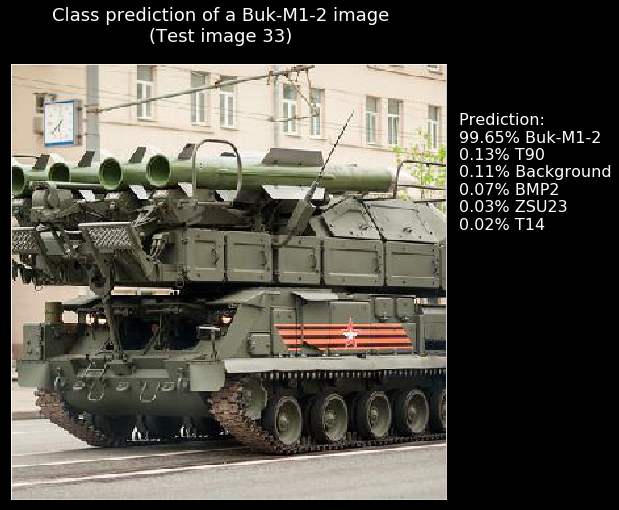

Image 34 : [(99.41, 'Buk-M1-2'), (0.35, 'ZSU23'), (0.13, 'Background'), (0.06, 'T90'), (0.03, 'T14'), (0.03, 'BMP2')]


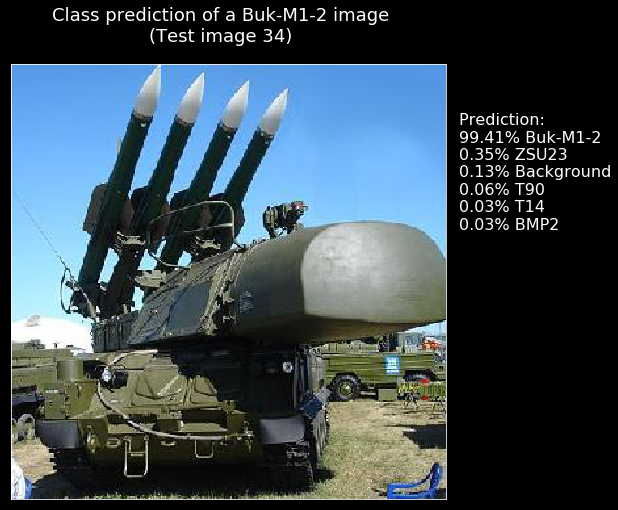

Image 35 : [(95.73, 'Buk-M1-2'), (2.11, 'Background'), (0.88, 'T90'), (0.63, 'T14'), (0.45, 'BMP2'), (0.2, 'ZSU23')]


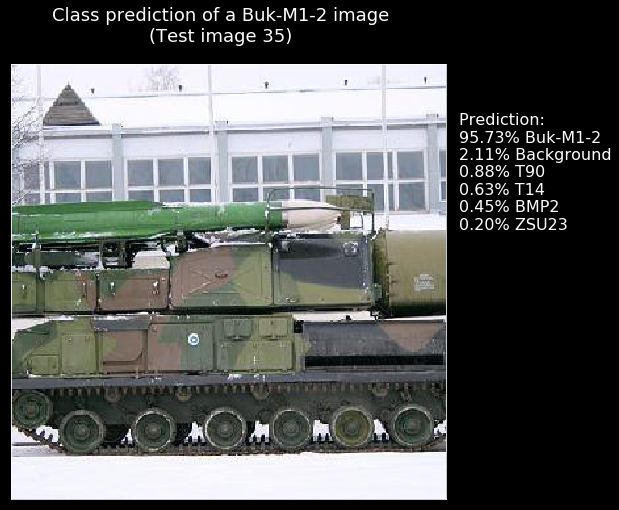

Image 36 : [(97.28, 'Buk-M1-2'), (0.95, 'Background'), (0.94, 'T90'), (0.67, 'ZSU23'), (0.1, 'BMP2'), (0.06, 'T14')]


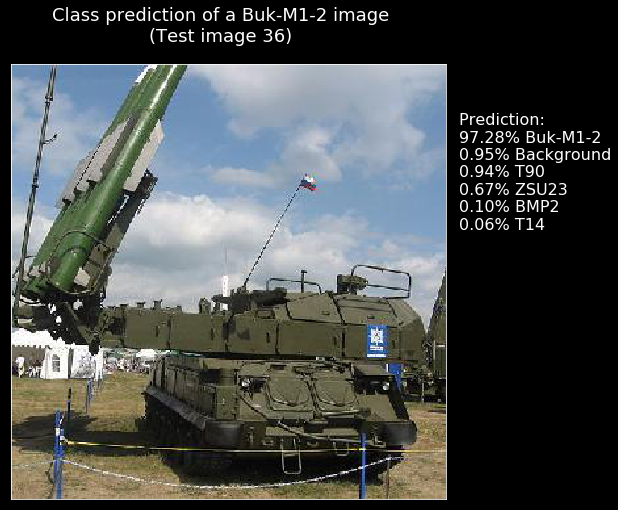

Image 37 : [(96.54, 'Buk-M1-2'), (1.08, 'BMP2'), (0.85, 'T90'), (0.73, 'ZSU23'), (0.66, 'Background'), (0.15, 'T14')]


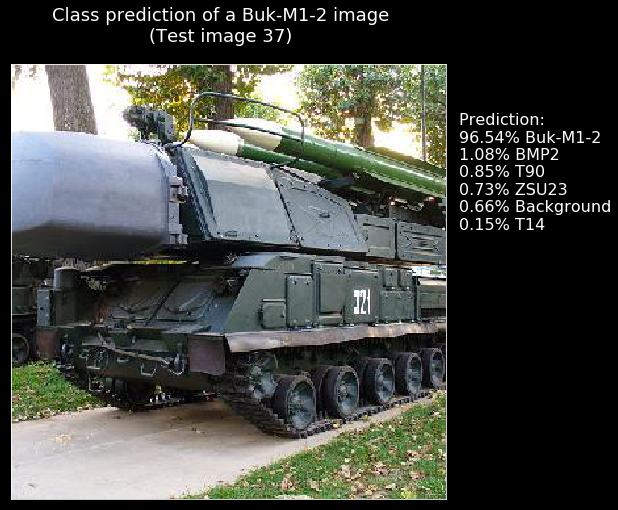

Image 38 : [(99.34, 'Buk-M1-2'), (0.47, 'ZSU23'), (0.13, 'Background'), (0.03, 'BMP2'), (0.02, 'T90'), (0.0, 'T14')]


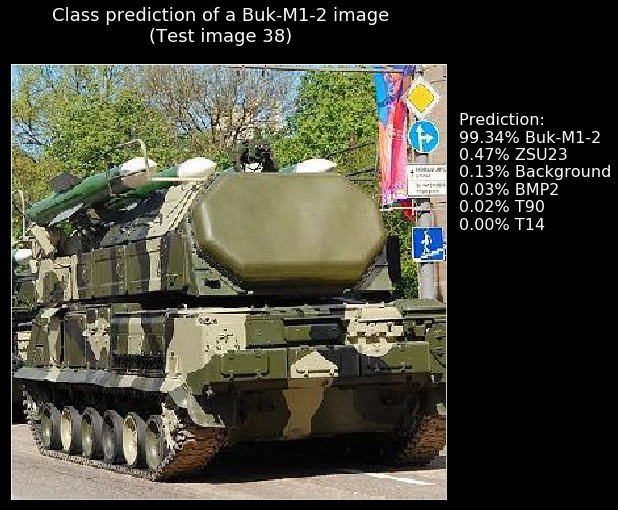

Image 39 : [(98.08, 'Buk-M1-2'), (0.86, 'T90'), (0.4, 'BMP2'), (0.33, 'ZSU23'), (0.28, 'Background'), (0.04, 'T14')]


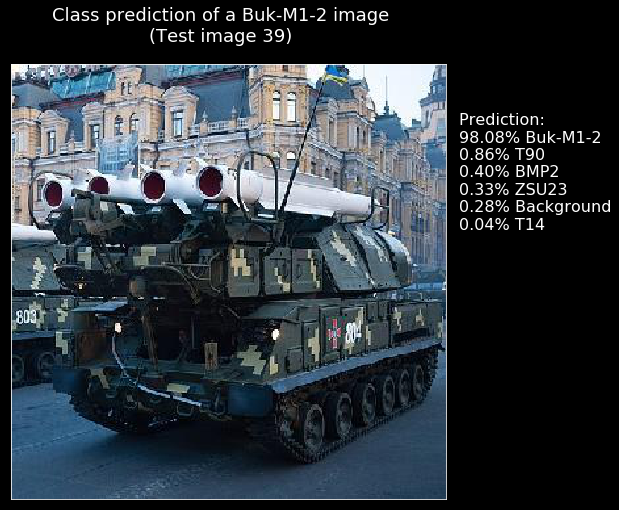

Image 40 : [(99.75, 'Buk-M1-2'), (0.16, 'Background'), (0.07, 'T90'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.01, 'BMP2')]


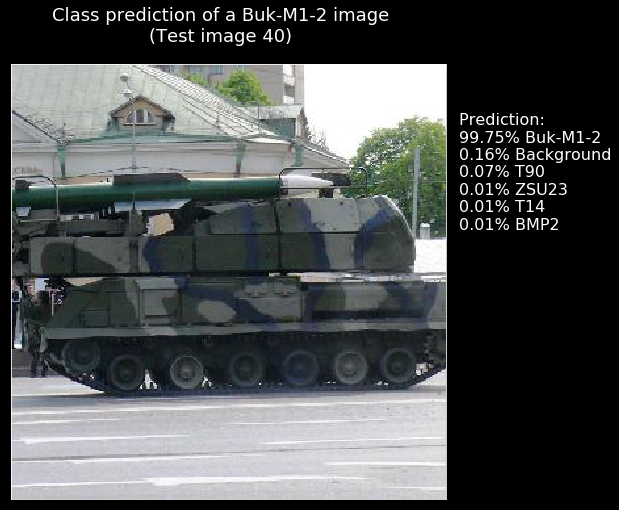

Image 41 : [(96.6, 'Buk-M1-2'), (2.92, 'ZSU23'), (0.34, 'BMP2'), (0.07, 'T90'), (0.04, 'Background'), (0.02, 'T14')]


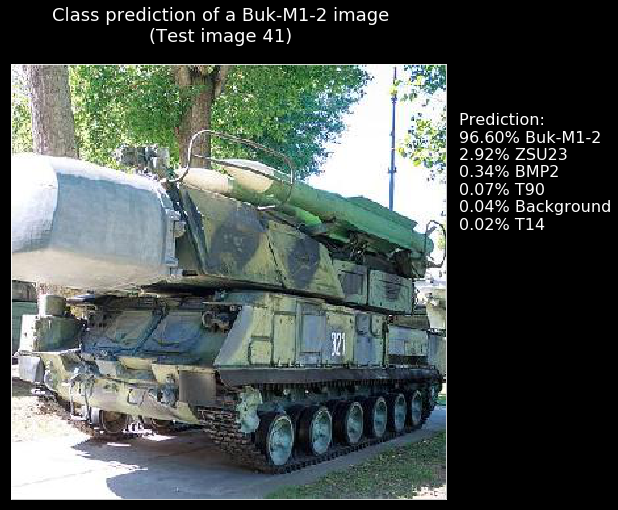

Image 42 : [(99.96, 'Buk-M1-2'), (0.01, 'ZSU23'), (0.01, 'T14'), (0.01, 'Background'), (0.01, 'BMP2'), (0.0, 'T90')]


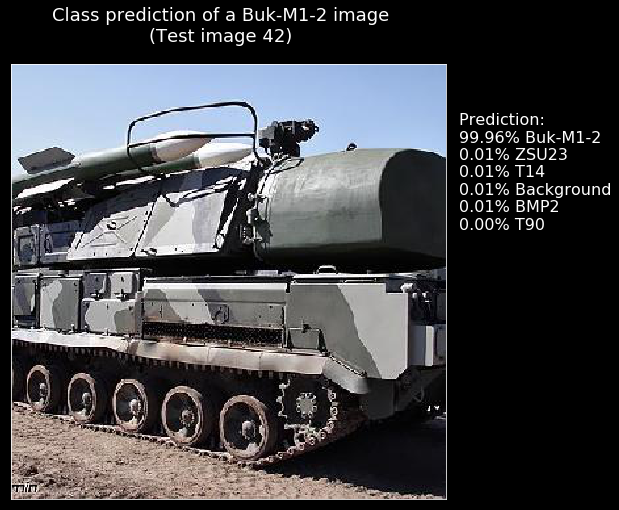

Image 43 : [(96.3, 'Buk-M1-2'), (2.33, 'BMP2'), (0.61, 'T90'), (0.46, 'ZSU23'), (0.17, 'Background'), (0.12, 'T14')]


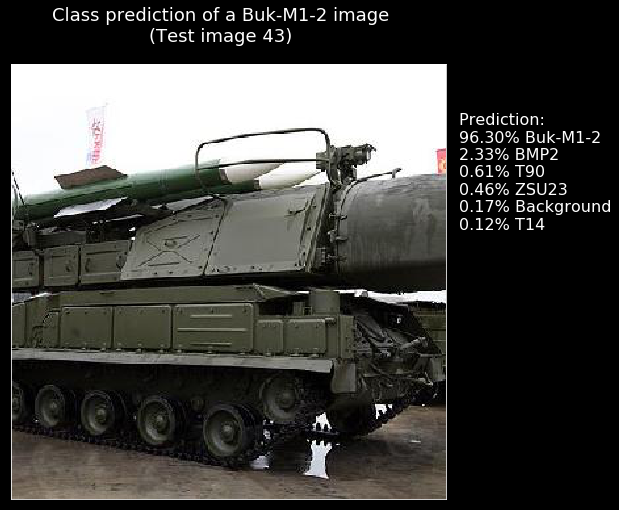

Image 44 : [(87.23, 'Buk-M1-2'), (6.8, 'T90'), (2.57, 'BMP2'), (2.33, 'Background'), (0.87, 'ZSU23'), (0.19, 'T14')]


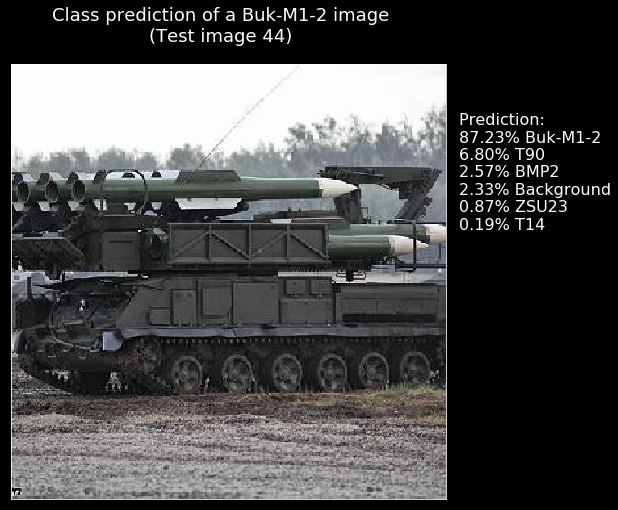

Image 45 : [(98.57, 'Buk-M1-2'), (0.94, 'Background'), (0.18, 'T90'), (0.14, 'BMP2'), (0.11, 'ZSU23'), (0.07, 'T14')]


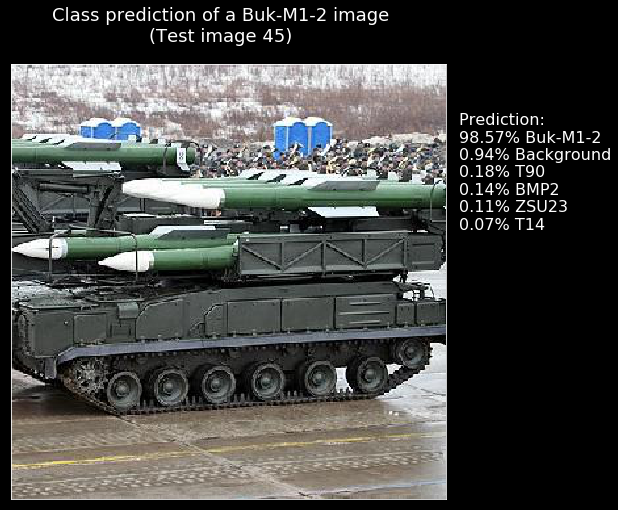

Image 46 : [(97.84, 'BMP2'), (1.42, 'T14'), (0.58, 'T90'), (0.09, 'Background'), (0.05, 'ZSU23'), (0.03, 'Buk-M1-2')]


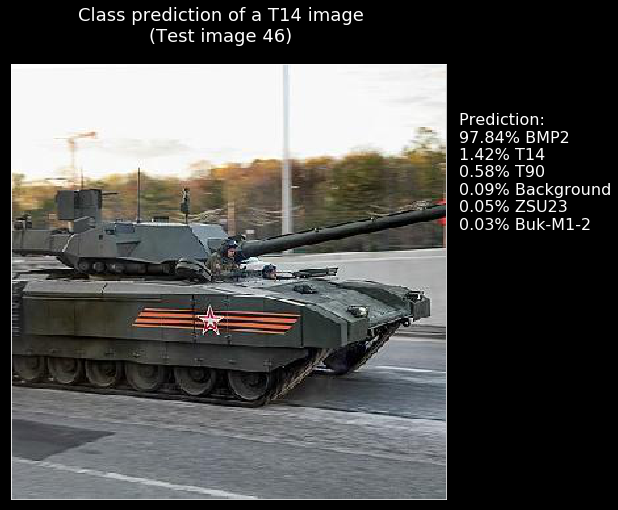

Image 47 : [(55.18, 'BMP2'), (25.96, 'T14'), (6.79, 'Background'), (4.65, 'Buk-M1-2'), (3.98, 'T90'), (3.45, 'ZSU23')]


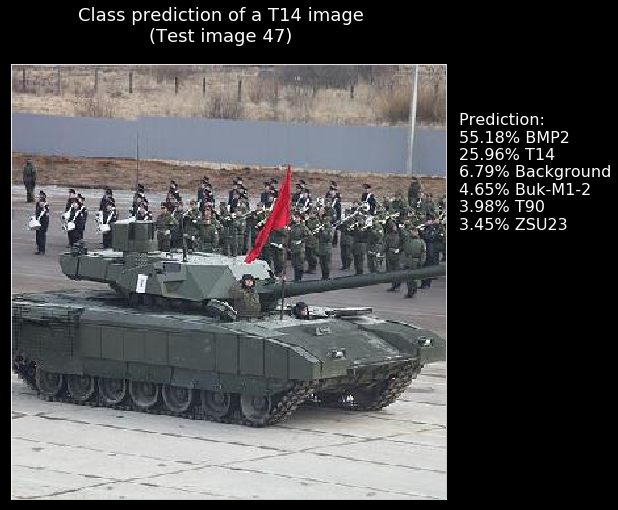

Image 48 : [(74.94, 'Buk-M1-2'), (16.77, 'BMP2'), (4.11, 'T90'), (2.19, 'T14'), (1.4, 'Background'), (0.6, 'ZSU23')]


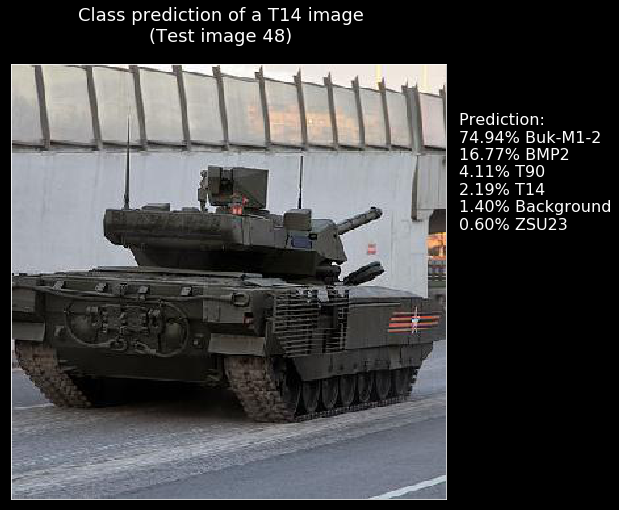

Image 49 : [(61.76, 'T14'), (27.16, 'BMP2'), (8.26, 'T90'), (1.29, 'Background'), (1.13, 'Buk-M1-2'), (0.41, 'ZSU23')]


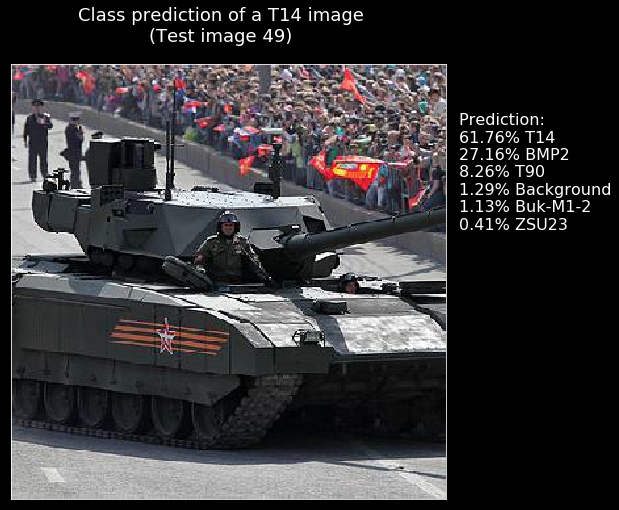

Image 50 : [(58.61, 'Buk-M1-2'), (17.17, 'ZSU23'), (12.08, 'Background'), (9.77, 'T14'), (1.73, 'BMP2'), (0.64, 'T90')]


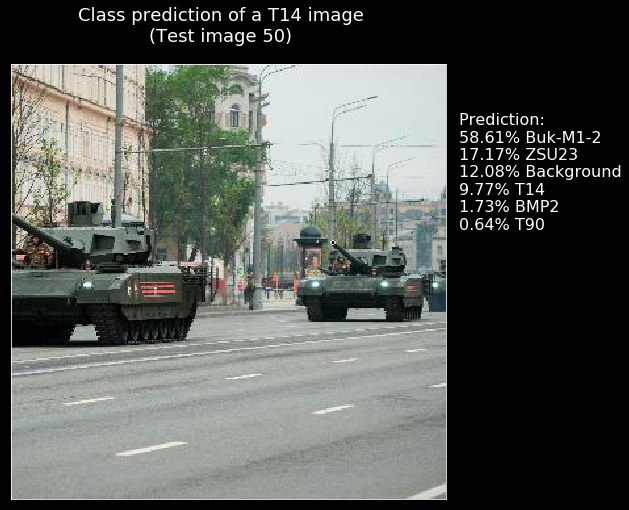

Image 51 : [(66.08, 'T14'), (31.75, 'BMP2'), (1.55, 'Background'), (0.24, 'Buk-M1-2'), (0.2, 'T90'), (0.19, 'ZSU23')]


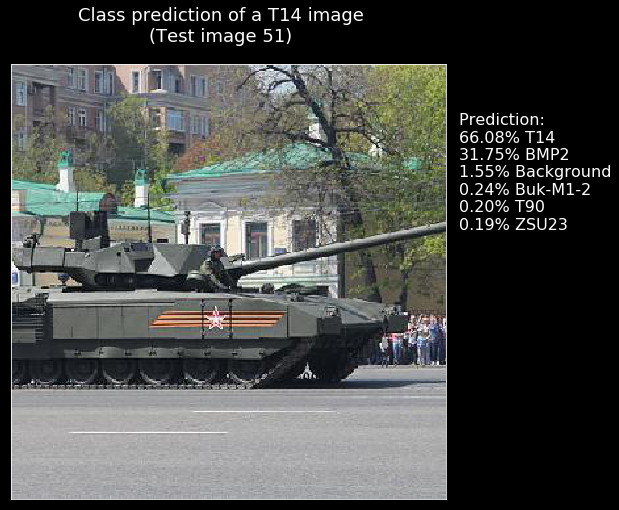

Image 52 : [(82.38, 'T14'), (12.7, 'T90'), (2.12, 'BMP2'), (1.58, 'Background'), (1.12, 'Buk-M1-2'), (0.1, 'ZSU23')]


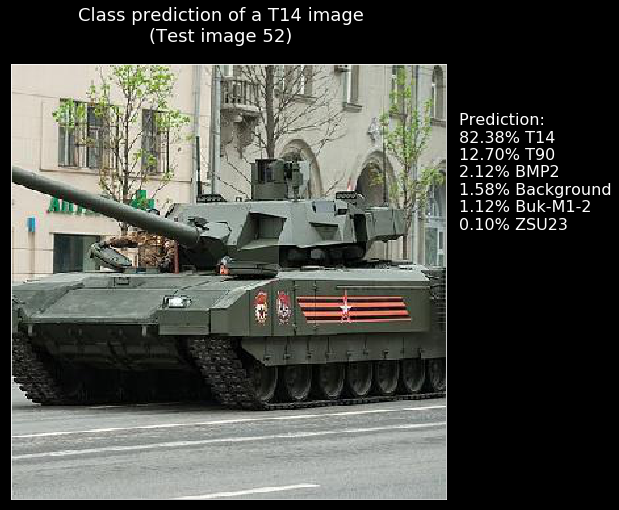

Image 53 : [(52.03, 'T14'), (21.47, 'Buk-M1-2'), (19.07, 'BMP2'), (4.58, 'T90'), (1.83, 'Background'), (1.02, 'ZSU23')]


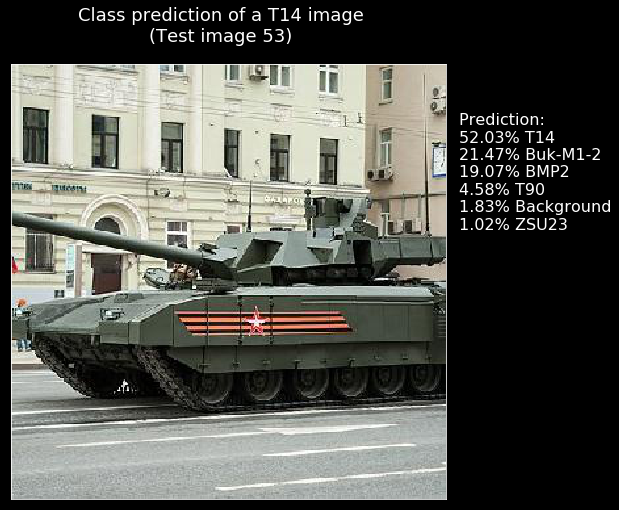

Image 54 : [(60.48, 'T14'), (39.12, 'BMP2'), (0.3, 'ZSU23'), (0.05, 'Background'), (0.04, 'Buk-M1-2'), (0.01, 'T90')]


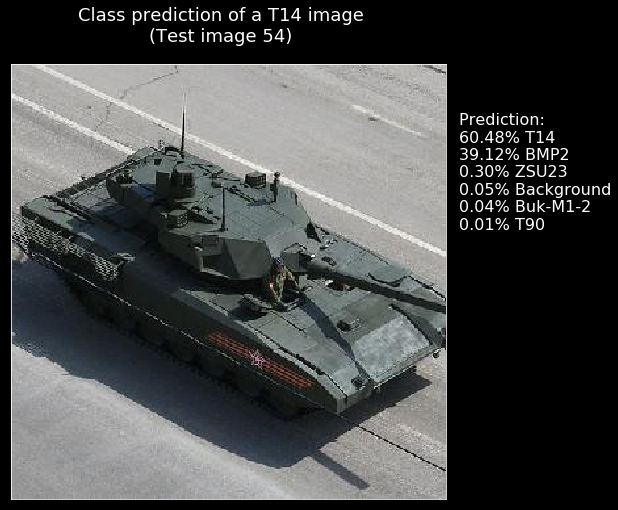

Image 55 : [(66.13, 'ZSU23'), (31.47, 'Buk-M1-2'), (1.5, 'T90'), (0.76, 'Background'), (0.11, 'BMP2'), (0.03, 'T14')]


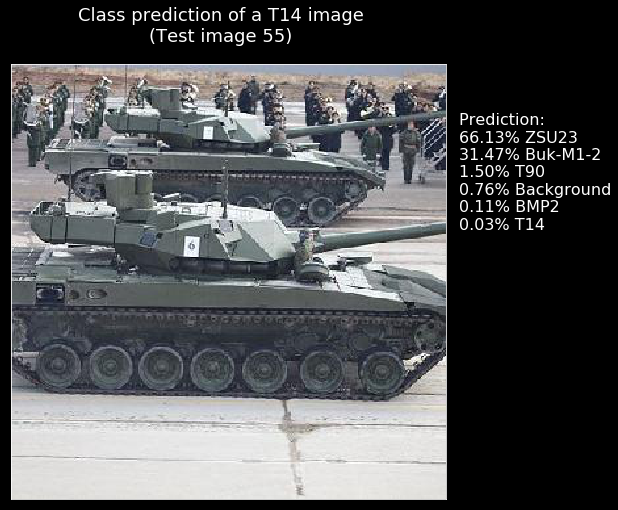

Image 56 : [(52.55, 'ZSU23'), (37.05, 'Buk-M1-2'), (4.88, 'BMP2'), (4.58, 'T14'), (0.65, 'T90'), (0.3, 'Background')]


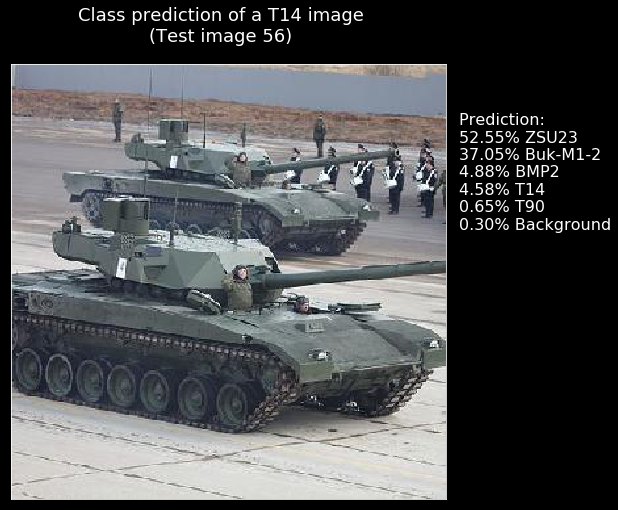

Image 57 : [(50.25, 'T14'), (34.94, 'Buk-M1-2'), (12.0, 'T90'), (1.2, 'BMP2'), (1.19, 'Background'), (0.42, 'ZSU23')]


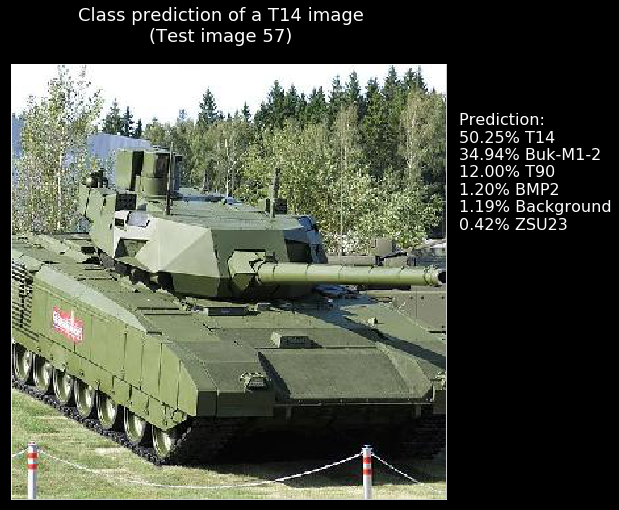

Image 58 : [(88.14, 'T14'), (7.14, 'T90'), (1.95, 'Background'), (1.32, 'Buk-M1-2'), (0.82, 'BMP2'), (0.63, 'ZSU23')]


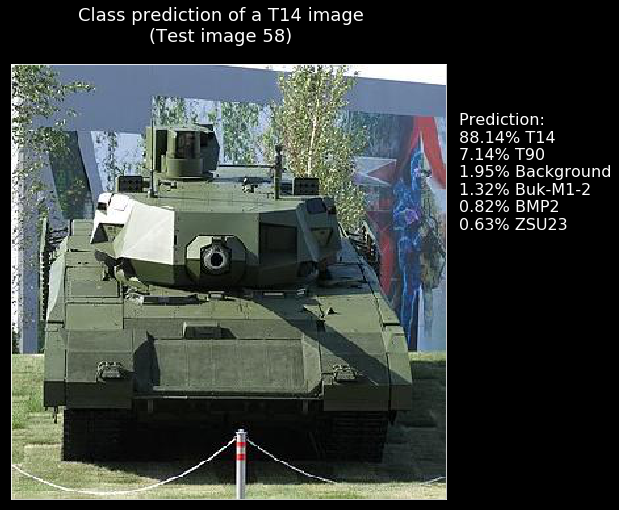

Image 59 : [(60.71, 'T14'), (20.95, 'Buk-M1-2'), (9.04, 'ZSU23'), (7.36, 'T90'), (1.89, 'BMP2'), (0.05, 'Background')]


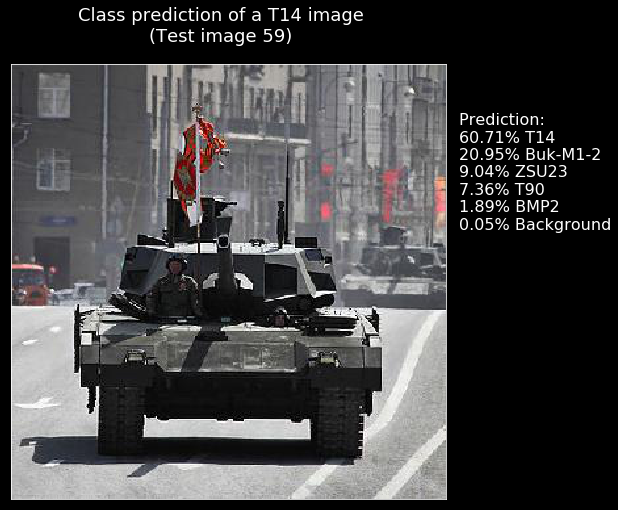

Image 60 : [(85.38, 'T14'), (9.33, 'T90'), (3.56, 'BMP2'), (1.32, 'Background'), (0.36, 'Buk-M1-2'), (0.05, 'ZSU23')]


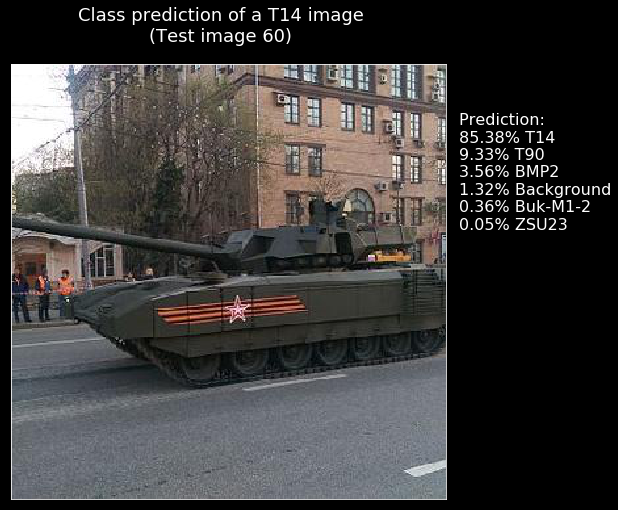

Image 61 : [(91.18, 'T90'), (7.18, 'T14'), (0.65, 'Buk-M1-2'), (0.52, 'BMP2'), (0.34, 'Background'), (0.14, 'ZSU23')]


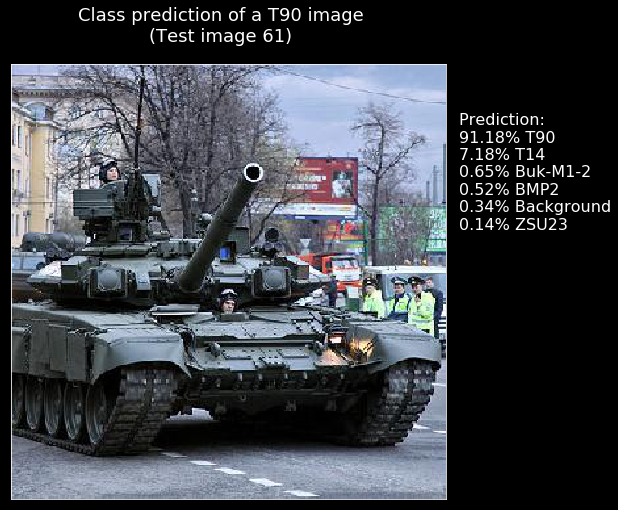

Image 62 : [(96.22, 'T90'), (1.44, 'T14'), (1.08, 'BMP2'), (0.53, 'Buk-M1-2'), (0.38, 'Background'), (0.35, 'ZSU23')]


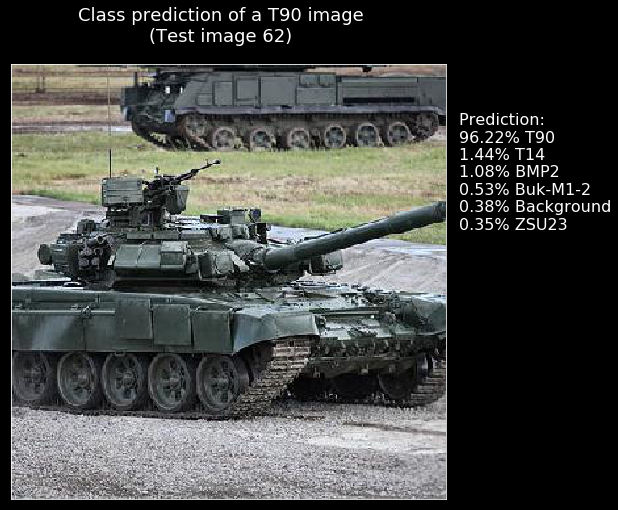

Image 63 : [(83.38, 'T90'), (12.71, 'T14'), (2.5, 'BMP2'), (0.63, 'Background'), (0.61, 'Buk-M1-2'), (0.17, 'ZSU23')]


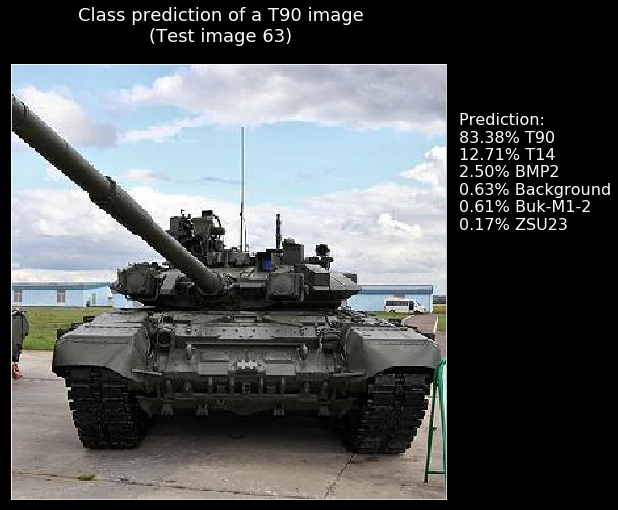

Image 64 : [(99.08, 'T90'), (0.62, 'T14'), (0.12, 'Buk-M1-2'), (0.09, 'Background'), (0.08, 'BMP2'), (0.01, 'ZSU23')]


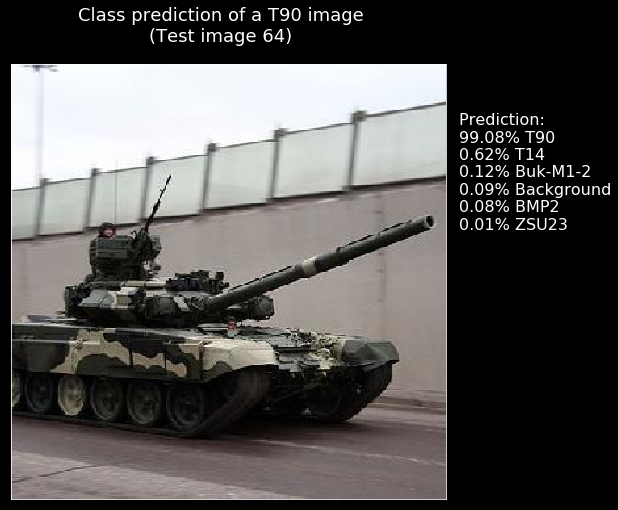

Image 65 : [(86.84, 'T90'), (5.55, 'Buk-M1-2'), (4.42, 'ZSU23'), (2.08, 'T14'), (0.77, 'Background'), (0.34, 'BMP2')]


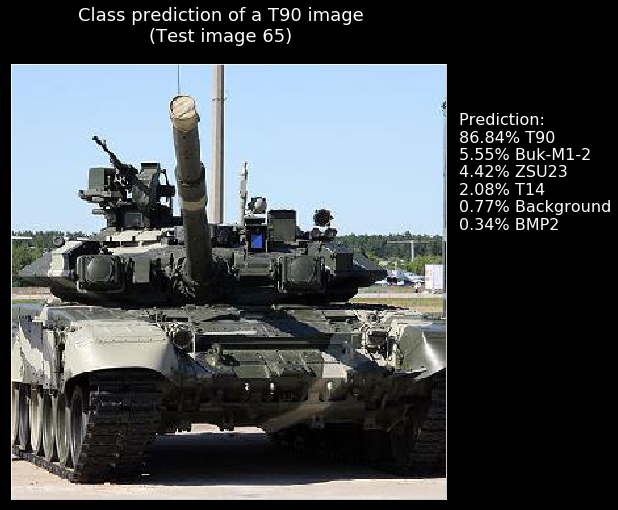

Image 66 : [(91.29, 'T90'), (7.32, 'T14'), (0.69, 'Buk-M1-2'), (0.3, 'BMP2'), (0.27, 'ZSU23'), (0.13, 'Background')]


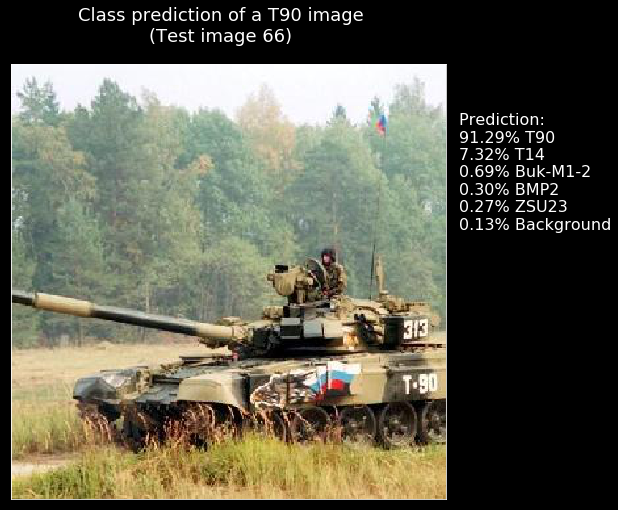

Image 67 : [(96.12, 'T90'), (2.01, 'Buk-M1-2'), (1.09, 'T14'), (0.53, 'Background'), (0.21, 'BMP2'), (0.04, 'ZSU23')]


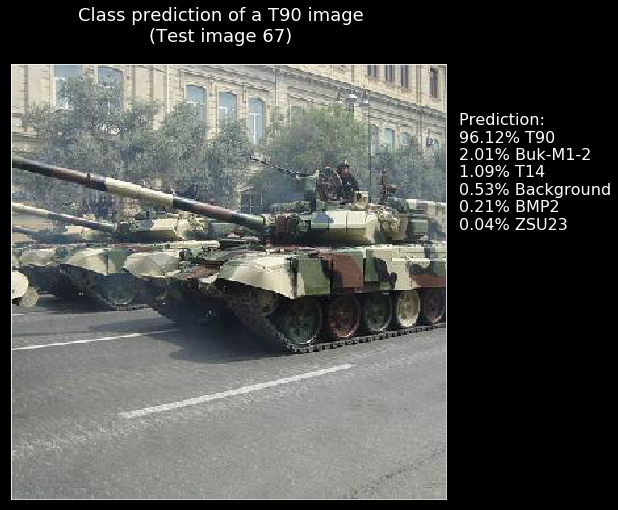

Image 68 : [(96.56, 'T90'), (2.12, 'T14'), (0.57, 'Buk-M1-2'), (0.35, 'ZSU23'), (0.21, 'BMP2'), (0.2, 'Background')]


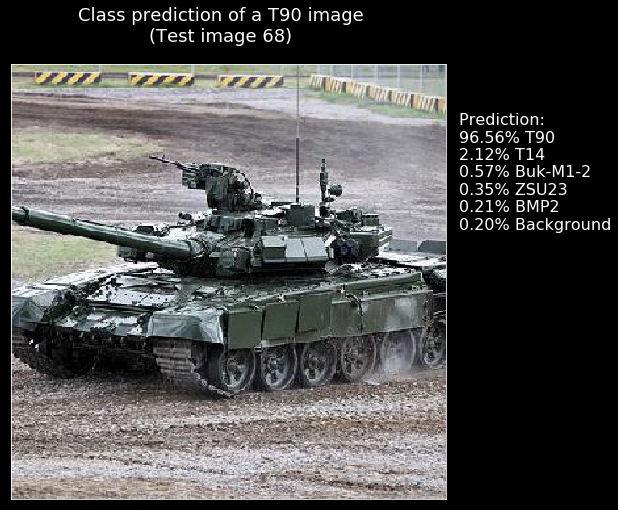

Image 69 : [(64.88, 'T14'), (12.95, 'ZSU23'), (12.53, 'Buk-M1-2'), (7.75, 'T90'), (1.32, 'Background'), (0.58, 'BMP2')]


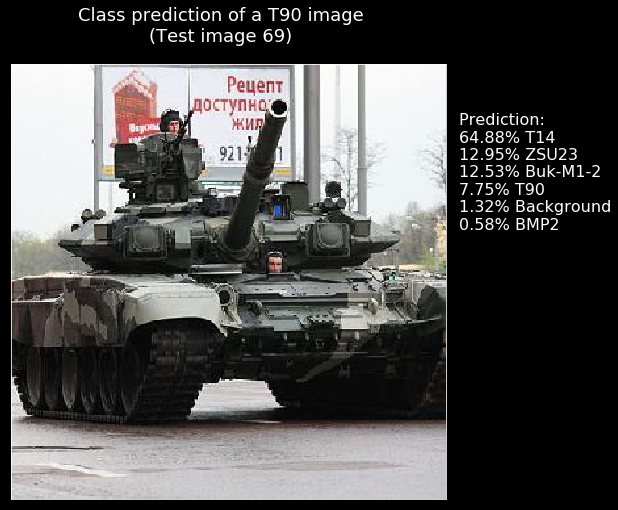

Image 70 : [(84.05, 'T90'), (13.12, 'Buk-M1-2'), (1.14, 'T14'), (0.96, 'BMP2'), (0.53, 'Background'), (0.2, 'ZSU23')]


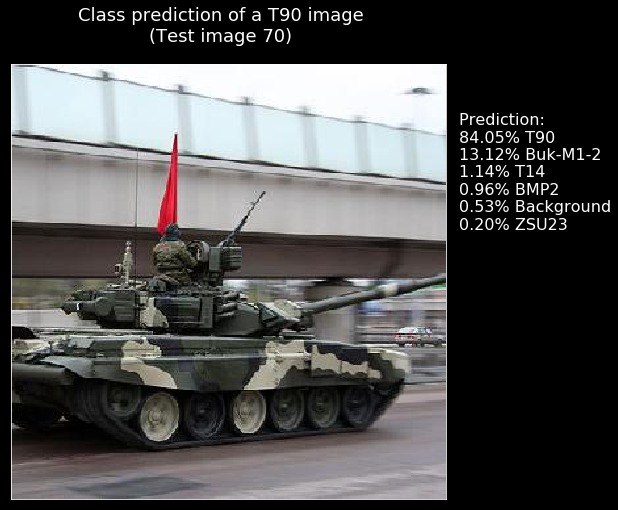

Image 71 : [(96.78, 'T90'), (1.66, 'Buk-M1-2'), (1.01, 'T14'), (0.24, 'Background'), (0.22, 'BMP2'), (0.1, 'ZSU23')]


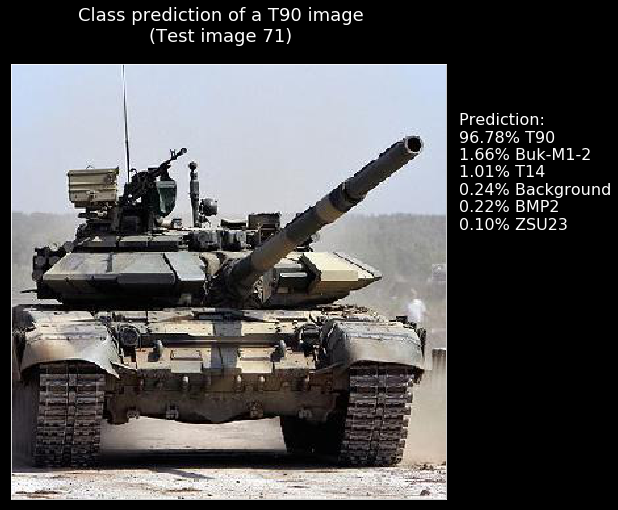

Image 72 : [(47.78, 'T90'), (25.84, 'Buk-M1-2'), (18.89, 'BMP2'), (5.45, 'ZSU23'), (1.18, 'Background'), (0.85, 'T14')]


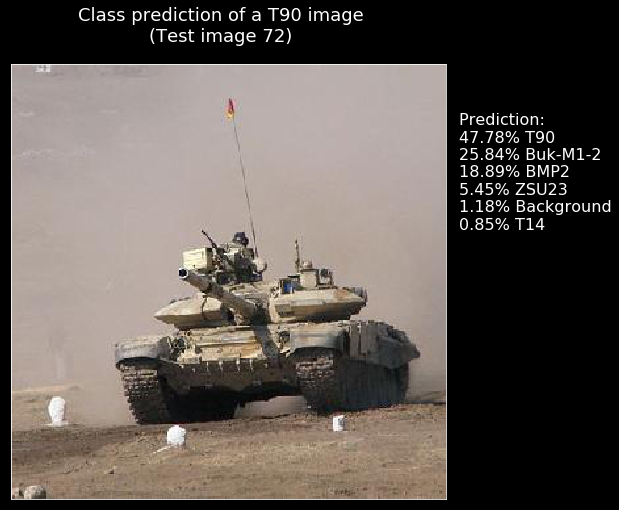

Image 73 : [(49.4, 'T90'), (45.8, 'T14'), (3.88, 'BMP2'), (0.4, 'Buk-M1-2'), (0.35, 'Background'), (0.18, 'ZSU23')]


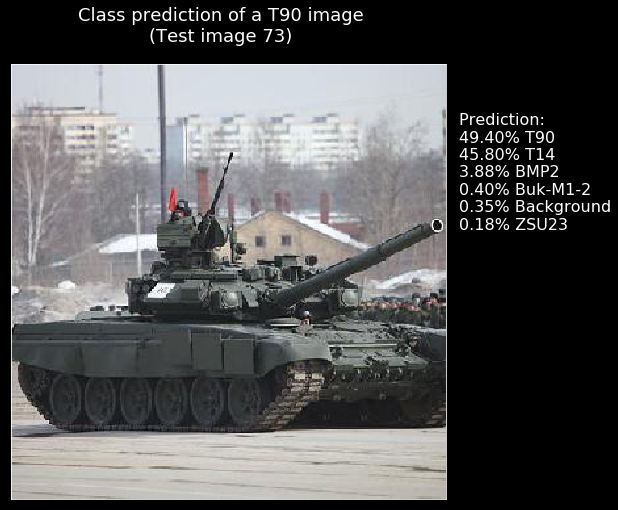

Image 74 : [(96.79, 'T90'), (2.22, 'T14'), (0.38, 'Buk-M1-2'), (0.28, 'BMP2'), (0.24, 'ZSU23'), (0.1, 'Background')]


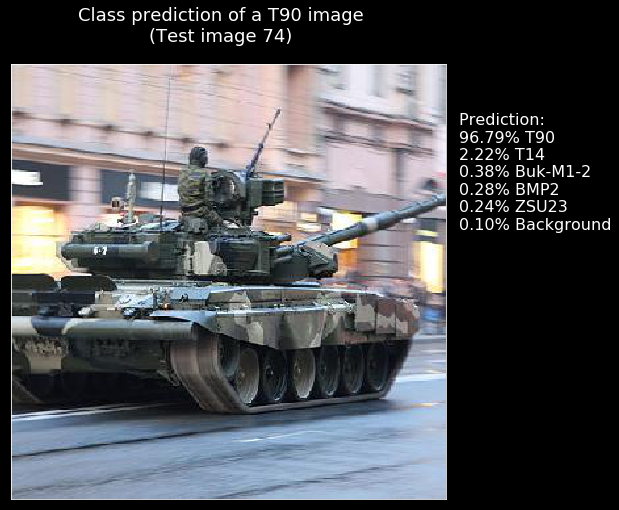

Image 75 : [(72.69, 'T90'), (23.97, 'T14'), (1.45, 'BMP2'), (0.94, 'Background'), (0.85, 'Buk-M1-2'), (0.11, 'ZSU23')]


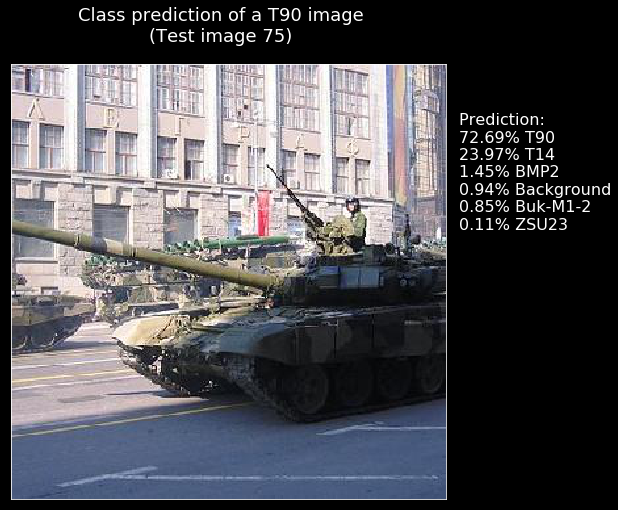

Image 76 : [(87.73, 'ZSU23'), (12.04, 'Buk-M1-2'), (0.13, 'Background'), (0.07, 'T90'), (0.03, 'BMP2'), (0.01, 'T14')]


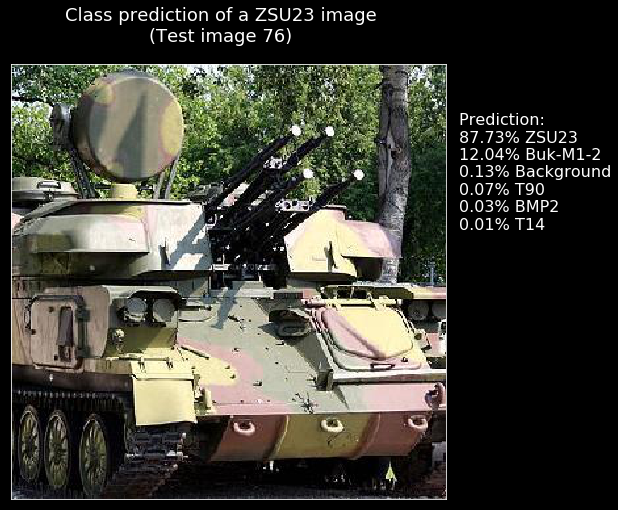

Image 77 : [(85.12, 'Buk-M1-2'), (12.28, 'ZSU23'), (1.82, 'T90'), (0.67, 'Background'), (0.06, 'BMP2'), (0.05, 'T14')]


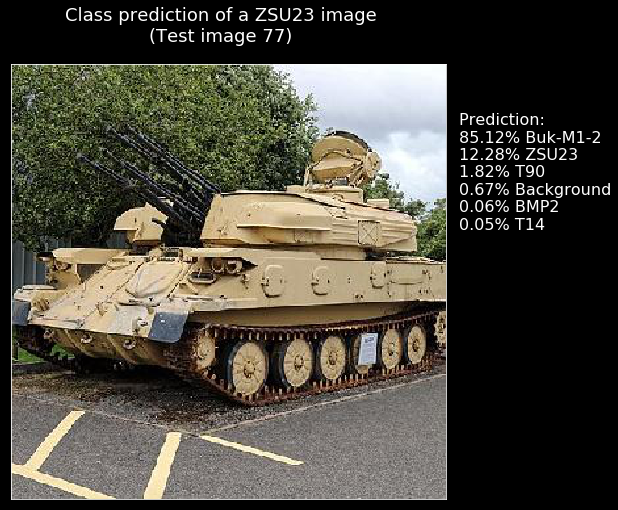

Image 78 : [(94.88, 'Buk-M1-2'), (3.57, 'ZSU23'), (0.82, 'T90'), (0.36, 'BMP2'), (0.31, 'Background'), (0.06, 'T14')]


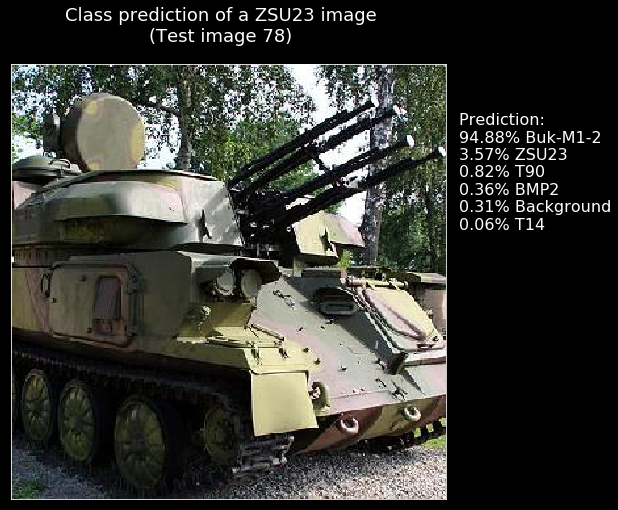

Image 79 : [(98.3, 'ZSU23'), (1.7, 'Buk-M1-2'), (0.0, 'T90'), (0.0, 'T14'), (0.0, 'Background'), (0.0, 'BMP2')]


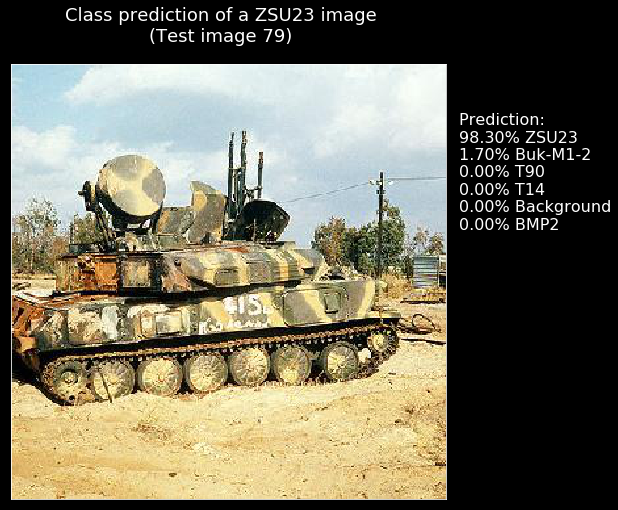

Image 80 : [(62.85, 'ZSU23'), (36.56, 'Buk-M1-2'), (0.33, 'BMP2'), (0.14, 'Background'), (0.1, 'T90'), (0.02, 'T14')]


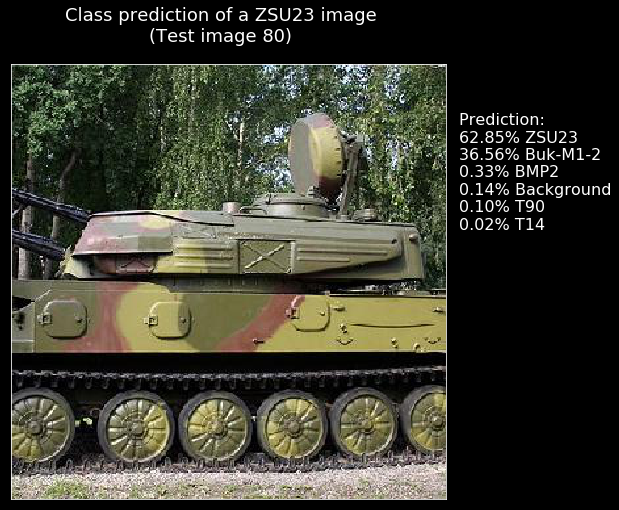

Image 81 : [(55.4, 'ZSU23'), (44.03, 'Buk-M1-2'), (0.44, 'Background'), (0.11, 'T90'), (0.02, 'BMP2'), (0.0, 'T14')]


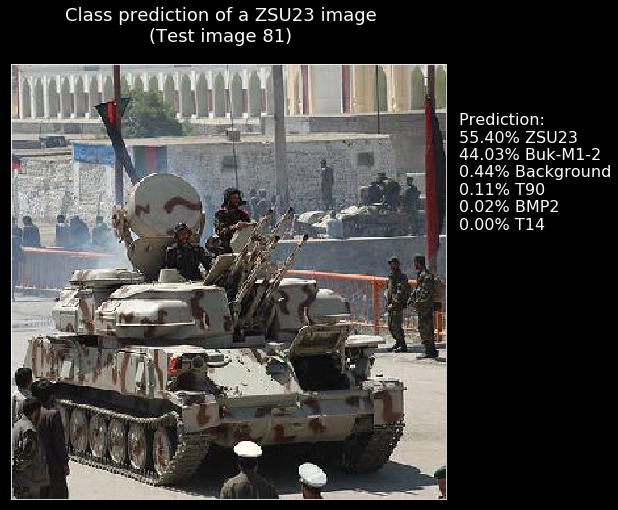

Image 82 : [(72.84, 'ZSU23'), (21.66, 'Buk-M1-2'), (2.8, 'Background'), (1.44, 'BMP2'), (1.11, 'T90'), (0.14, 'T14')]


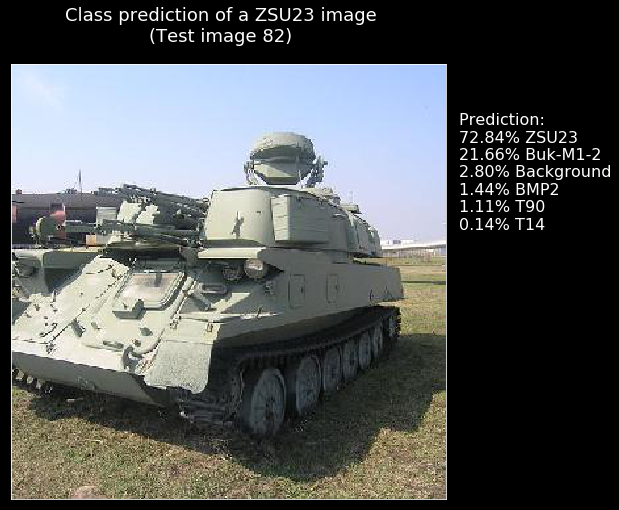

Image 83 : [(98.13, 'Buk-M1-2'), (0.7, 'T90'), (0.66, 'ZSU23'), (0.4, 'T14'), (0.06, 'BMP2'), (0.05, 'Background')]


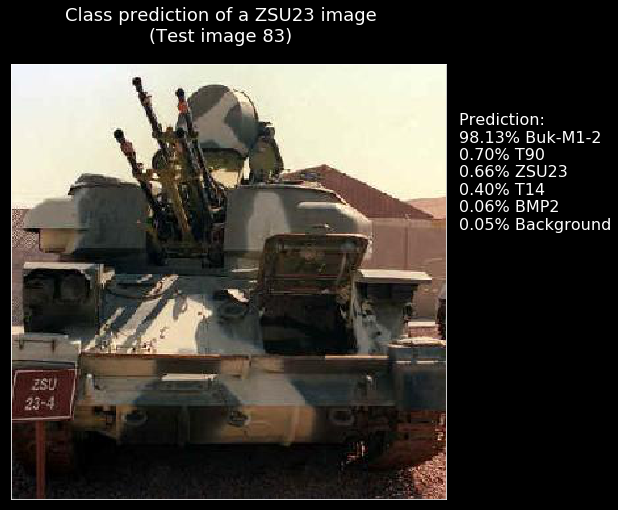

Image 84 : [(57.06, 'Buk-M1-2'), (36.04, 'ZSU23'), (2.69, 'Background'), (2.03, 'T14'), (1.53, 'BMP2'), (0.66, 'T90')]


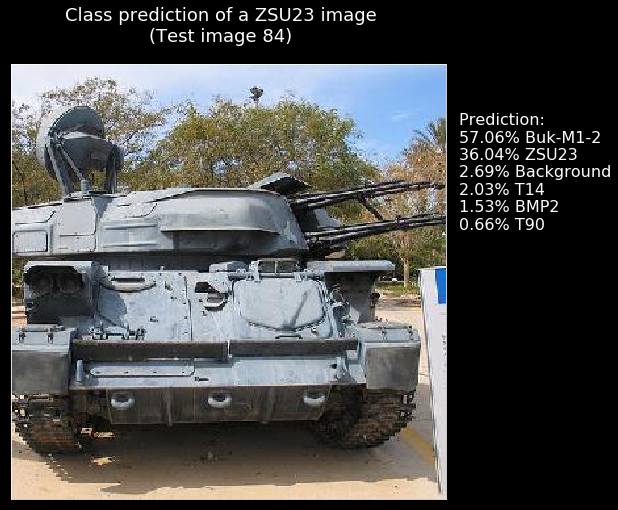

Image 85 : [(99.48, 'Buk-M1-2'), (0.32, 'ZSU23'), (0.13, 'T14'), (0.05, 'BMP2'), (0.02, 'T90'), (0.0, 'Background')]


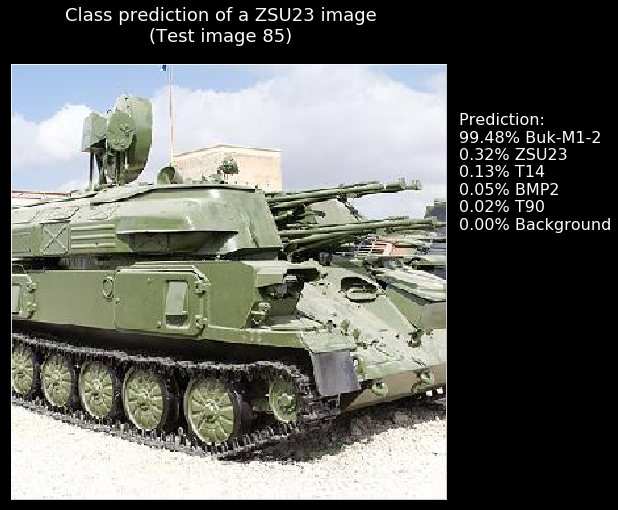

Image 86 : [(99.8, 'ZSU23'), (0.17, 'Buk-M1-2'), (0.01, 'T90'), (0.01, 'Background'), (0.01, 'BMP2'), (0.0, 'T14')]


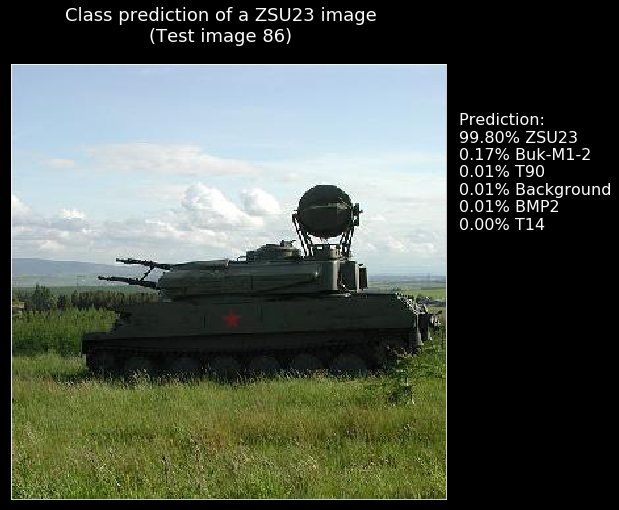

Image 87 : [(83.06, 'ZSU23'), (15.67, 'Buk-M1-2'), (0.78, 'BMP2'), (0.26, 'Background'), (0.23, 'T90'), (0.01, 'T14')]


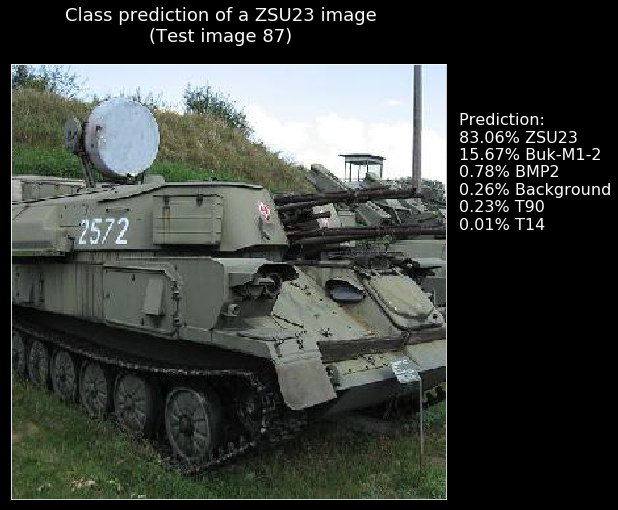

Image 88 : [(99.52, 'ZSU23'), (0.46, 'Buk-M1-2'), (0.01, 'T90'), (0.01, 'Background'), (0.01, 'BMP2'), (0.0, 'T14')]


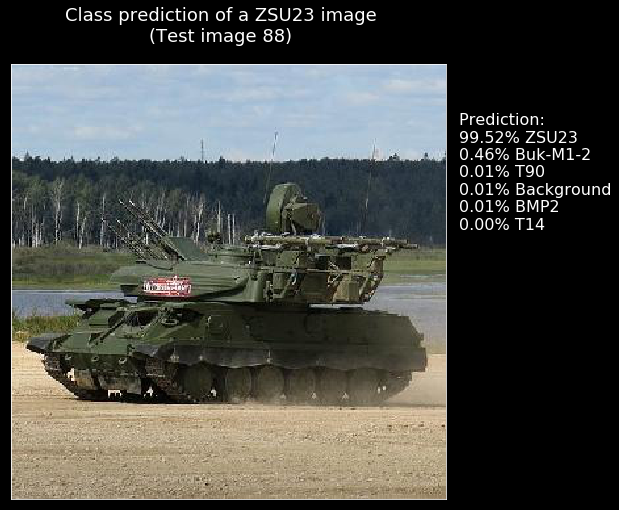

Image 89 : [(98.94, 'ZSU23'), (0.8, 'Buk-M1-2'), (0.2, 'T90'), (0.04, 'Background'), (0.02, 'BMP2'), (0.0, 'T14')]


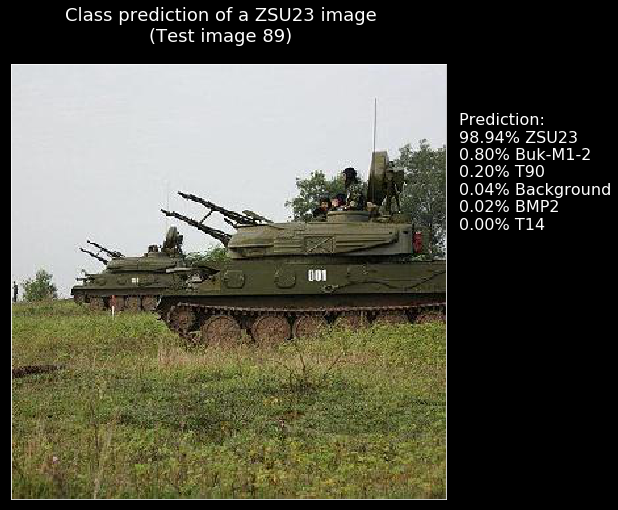

Image 90 : [(82.59, 'BMP2'), (9.1, 'ZSU23'), (7.64, 'T14'), (0.33, 'Buk-M1-2'), (0.27, 'Background'), (0.06, 'T90')]


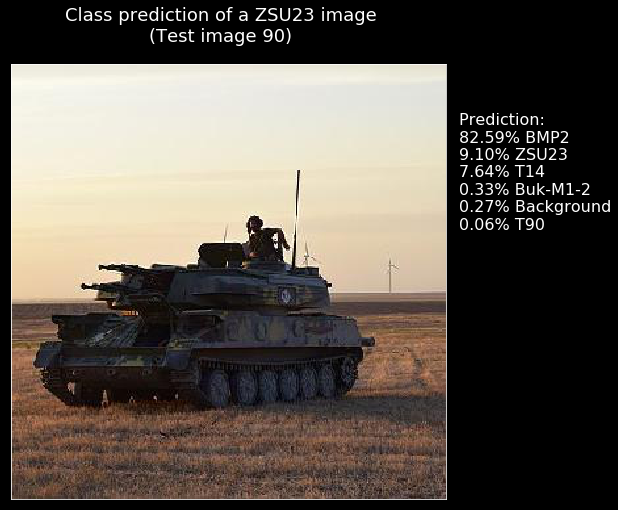

In [23]:
plot_images()